In [1]:
import os
%load_ext autoreload
%autoreload 2

# compare source,target, mixmatch

In [2]:
root_path = '/home/lhw0772/SHOT-plus/code/uda/vit'
task = 'uda'
dataset = 'office-home'

protocol_type_list =  ['source', 'target', 'mixmatch']


source_dict ={}
target_dict ={}
mixmatch_dict ={}


for protocol in protocol_type_list:
    path  = os.path.join(root_path,protocol,task,dataset)
    domain_list = os.listdir(path)
    domain_list.sort()
    
    for domain in domain_list:
        npath  = os.path.join(root_path,protocol,task,dataset,domain)
        print (npath)
        
        if protocol == 'source':
            out = open(os.path.join (npath,'log_test.txt')).readlines()[1:]
            
            for line in out:
                dm = line.split(',')[0].split(': ')[1]
                acc = float(line.split(' = ')[1].split('%')[0])
                source_dict[dm] = acc
            
            
        elif protocol == 'target':
            file_list = os.listdir(npath)
            
            
            for file in file_list:
                if file.endswith('.txt'):
                    line = open(os.path.join(npath,file)).readlines()[-1].split('\n')[0]
                    
                    dm = line.split(',')[0].split(': ')[1]
                    acc = float(line.split(' = ')[1].split('%')[0])
                    target_dict[dm] = acc
                    
        else:
            file_list = os.listdir(npath)
            
            for file in file_list:
                if file.endswith('.txt'):
                    line = open(os.path.join(npath,file)).readlines()[-2].split('\n')[0]
                    dm = npath.split('/')[-1]
                    acc = float(line.split(' = ')[1].split('%')[0])
                    mixmatch_dict[dm] =acc
    
    



/home/lhw0772/SHOT-plus/code/uda/vit/source/uda/office-home/A
/home/lhw0772/SHOT-plus/code/uda/vit/source/uda/office-home/C
/home/lhw0772/SHOT-plus/code/uda/vit/source/uda/office-home/P
/home/lhw0772/SHOT-plus/code/uda/vit/source/uda/office-home/R
/home/lhw0772/SHOT-plus/code/uda/vit/target/uda/office-home/AC
/home/lhw0772/SHOT-plus/code/uda/vit/target/uda/office-home/AP
/home/lhw0772/SHOT-plus/code/uda/vit/target/uda/office-home/AR
/home/lhw0772/SHOT-plus/code/uda/vit/target/uda/office-home/CA
/home/lhw0772/SHOT-plus/code/uda/vit/target/uda/office-home/CP
/home/lhw0772/SHOT-plus/code/uda/vit/target/uda/office-home/CR
/home/lhw0772/SHOT-plus/code/uda/vit/target/uda/office-home/PA
/home/lhw0772/SHOT-plus/code/uda/vit/target/uda/office-home/PC
/home/lhw0772/SHOT-plus/code/uda/vit/target/uda/office-home/PR
/home/lhw0772/SHOT-plus/code/uda/vit/target/uda/office-home/RA
/home/lhw0772/SHOT-plus/code/uda/vit/target/uda/office-home/RC
/home/lhw0772/SHOT-plus/code/uda/vit/target/uda/office-home

In [3]:
source_dict = sorted(source_dict.items())
target_dict = sorted(target_dict.items())
mixmatch_dict = sorted(mixmatch_dict.items())

In [4]:
import pandas as pd

In [5]:
source_tb = pd.DataFrame.from_dict(source_dict).T
target_tb = pd.DataFrame.from_dict(target_dict).T
mixmatch_tb = pd.DataFrame.from_dict(mixmatch_dict).T

In [6]:
source_tb

,0,1,2,3,4,5,6,7,8,9,10,11
0,AC,AP,AR,CA,CP,CR,PA,PC,PR,RA,RC,RP
1,60.64,84.21,87.12,81.01,84.97,86.83,76.84,55.62,88.16,80.55,57.11,88.02


In [7]:
print ('avg : ',source_tb.iloc[1,:].mean())

avg :  77.58999999999999


In [8]:
target_tb

,0,1,2,3,4,5,6,7,8,9,10,11
0,AC,AP,AR,CA,CP,CR,PA,PC,PR,RA,RC,RP
1,71.57,87.65,89.44,85.58,88.58,89.37,81.17,67.79,89.72,83.72,71.04,91.91


In [9]:
print ('avg : ',target_tb.iloc[1,:].mean())

avg :  83.12833333333333


In [10]:
mixmatch_tb

,0,1,2,3,4,5,6,7,8,9,10,11
0,AC,AP,AR,CA,CP,CR,PA,PC,PR,RA,RC,RP
1,71.02,88.04,89.88,85.66,89.05,89.63,81.09,67.12,89.74,83.97,70.38,92.05


In [11]:
print ('avg : ',mixmatch_tb.iloc[1,:].mean())

avg :  83.13583333333334


In [12]:
import timm
from torchinfo import summary

In [13]:
netF = timm.create_model('vit_base_patch16_224', pretrained=True).cuda()

In [14]:
summary(netF,(1,3,224,224))

Layer (type:depth-idx)                   Output Shape              Param #
VisionTransformer                        [1, 1000]                 152,064
├─PatchEmbed: 1-1                        [1, 196, 768]             --
│    └─Conv2d: 2-1                       [1, 768, 14, 14]          590,592
│    └─Identity: 2-2                     [1, 196, 768]             --
├─Dropout: 1-2                           [1, 197, 768]             --
├─Identity: 1-3                          [1, 197, 768]             --
├─Sequential: 1-4                        [1, 197, 768]             --
│    └─Block: 2-3                        [1, 197, 768]             --
│    │    └─LayerNorm: 3-1               [1, 197, 768]             1,536
│    │    └─Attention: 3-2               [1, 197, 768]             2,362,368
│    │    └─Identity: 3-3                [1, 197, 768]             --
│    │    └─Identity: 3-4                [1, 197, 768]             --
│    │    └─LayerNorm: 3-5               [1, 197, 768]           

# SHOT vs SDAT vs SHOT+SDAT 

In [15]:
import argparse
import os, sys
import os.path as osp
import torchvision
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
import network
import loss
from torch.utils.data import DataLoader
from data_list import ImageList
import random, pdb, math, copy
from tqdm import tqdm
from loss import CrossEntropyLabelSmooth
from scipy.spatial.distance import cdist
from sklearn.metrics import confusion_matrix
from sklearn.cluster import KMeans

import timm
from torchinfo import summary
from typing import List, Dict
from torch.optim.lr_scheduler import LambdaLR
import torch.nn.functional as F
from typing import Optional, Any, Tuple
from torch.autograd import Function


__all__ = ['keypoint_detection']

from classifier import Classifier as ClassifierBase
from torchvision import models
from torchvision.models.resnet import BasicBlock, Bottleneck, model_urls

from torchvision.models.utils import load_state_dict_from_url


def cal_acc(loader, netF, netB, netC, flag=False):
    start_test = True
    with torch.no_grad():
        iter_test = iter(loader)
        for i in range(len(loader)):
            data = iter_test.next()
            inputs = data[0]
            labels = data[1]
            inputs = inputs.cuda()
            outputs = netC(netB(netF(inputs)))
            if start_test:
                all_output = outputs.float().cpu()
                all_label = labels.float()
                start_test = False
            else:
                all_output = torch.cat((all_output, outputs.float().cpu()), 0)
                all_label = torch.cat((all_label, labels.float()), 0)
    _, predict = torch.max(all_output, 1)
    accuracy = torch.sum(torch.squeeze(predict).float() == all_label).item() / float(all_label.size()[0])
    mean_ent = torch.mean(loss.Entropy(nn.Softmax(dim=1)(all_output))).cpu().data.item()

    if flag:
        matrix = confusion_matrix(all_label, torch.squeeze(predict).float())
        matrix = matrix[np.unique(all_label).astype(int),:]
        acc = matrix.diagonal()/matrix.sum(axis=1) * 100
        aacc = acc.mean()
        aa = [str(np.round(i, 2)) for i in acc]
        acc = ' '.join(aa)
        return aacc, acc
    else:
        return accuracy*100, mean_ent

In [16]:
def data_load(args): 
    ## prepare data
    dsets = {}
    dset_loaders = {}
    train_bs = args.batch_size
    txt_src = open(args.s_dset_path).readlines()
    txt_test = open(args.test_dset_path).readlines()
    
    print (len(txt_src), len(txt_test))

    dsize = len(txt_src)
    tr_size = int(0.9*dsize)
    # print(dsize, tr_size, dsize - tr_size)
    tr_txt, te_txt = torch.utils.data.random_split(txt_src, [tr_size, dsize - tr_size])
    
    #args.s_dset_path (source)
    #args.test_dset_path (target)

    dsets["source_tr"] = ImageList(tr_txt, transform=image_train())
    dset_loaders["source_tr"] = DataLoader(dsets["source_tr"], batch_size=train_bs, shuffle=True, 
        num_workers=args.worker, drop_last=True)

    dset_loaders["source_tr"] = ForeverDataIterator(dset_loaders["source_tr"])
    
    dsets["target_tr"] = ImageList(txt_test, transform=image_train())
    dset_loaders["target_tr"] = DataLoader(dsets["target_tr"], batch_size=train_bs, shuffle=True, 
        num_workers=args.worker, drop_last=True)
    
    dset_loaders["target_tr"] = ForeverDataIterator(dset_loaders["target_tr"])
    
    dsets["source_te"] = ImageList(te_txt, transform=image_test())
    dset_loaders["source_te"] = DataLoader(dsets["source_te"], batch_size=train_bs*3, shuffle=False, 
        num_workers=args.worker, drop_last=False)
    dsets["test"] = ImageList(txt_test, transform=image_test())
    dset_loaders["test"] = DataLoader(dsets["test"], batch_size=train_bs*3, shuffle=False, 
        num_workers=args.worker, drop_last=False)

    return dset_loaders

In [17]:
def image_train(resize_size=256, crop_size=224, alexnet=False):
    normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                   std=[0.229, 0.224, 0.225])
    return  transforms.Compose([
        transforms.Resize((resize_size, resize_size)),
        transforms.RandomCrop(crop_size),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        normalize
    ])

def image_test(resize_size=256, crop_size=224, alexnet=False):
    normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                   std=[0.229, 0.224, 0.225])
    return  transforms.Compose([
        transforms.Resize((resize_size, resize_size)),
        transforms.CenterCrop(crop_size),
        transforms.ToTensor(),
        normalize
    ])


class ForeverDataIterator:
    r"""A data iterator that will never stop producing data"""

    def __init__(self, data_loader: DataLoader, device=None):
        self.data_loader = data_loader
        self.iter = iter(self.data_loader)
        self.device = device

    def __next__(self):
        try:
            data = next(self.iter)
            if self.device is not None:
                data = data.cuda()
        except StopIteration:
            self.iter = iter(self.data_loader)
            data = next(self.iter)
            if self.device is not None:
                data = data.cuda()
        return data

    def __len__(self):
        return len(self.data_loader)

In [18]:
import argparse
import os

parser = argparse.ArgumentParser(description='SHOT++')
parser.add_argument('--gpu_id', type=str, nargs='?', default='0', help="device id to run")
parser.add_argument('--s', type=int, default=0, help="source")
parser.add_argument('--t', type=int, default=1, help="target")
parser.add_argument('--max_epoch', type=int, default=20, help="max iterations")
parser.add_argument('--batch_size', type=int, default=32, help="batch_size")
parser.add_argument('--worker', type=int, default=4, help="number of workers")
parser.add_argument('--dset', type=str, default='office-home', choices=['VISDA-C', 'office', 'office-home'])
parser.add_argument('--lr', type=float, default=1e-2, help="learning rate")
parser.add_argument('--net', type=str, default='resnet50', help="vgg16, resnet18, resnet34, resnet50, resnet101")
parser.add_argument('--seed', type=int, default=2020, help="random seed")
parser.add_argument('--bottleneck', type=int, default=256)
parser.add_argument('--epsilon', type=float, default=1e-5)
parser.add_argument('--layer', type=str, default="wn", choices=["linear", "wn"])
parser.add_argument('--classifier', type=str, default="bn", choices=["ori", "bn", "bn_relu"])
parser.add_argument('--smooth', type=float, default=0.1)   
parser.add_argument('--output', type=str, default='san')
parser.add_argument('--da', type=str, default='uda', choices=['uda'])

parser.add_argument('--wd', '--weight-decay', default=1e-3, type=float,
                    metavar='W', help='weight decay (default: 1e-3)',
                    dest='weight_decay')
parser.add_argument('--rho', type=float, default=0.02, help="GPU ID")
parser.add_argument('--lr-gamma', default=0.001,
                    type=float, help='parameter for lr scheduler')
parser.add_argument('--lr-decay', default=0.75,
                    type=float, help='parameter for lr scheduler')
parser.add_argument('--momentum', default=0.9,
                    type=float, metavar='M', help='momentum')   
parser.add_argument('--temperature', default=2.0,
                    type=float, help='parameter temperature scaling')
parser.add_argument('--entropy', default=False,
                    action='store_true', help='use entropy conditioning')
parser.add_argument('-r', '--randomized', action='store_true',
                    help='using randomized multi-linear-map (default: False)')
parser.add_argument('-rd', '--randomized-dim', default=1024, type=int,
                    help='randomized dimension when using randomized multi-linear-map (default: 1024)')
parser.add_argument('--trade-off', default=1., type=float,
                    help='the trade-off hyper-parameter for transfer loss')    
parser.add_argument('--log_results', action='store_true',
                    help="To log results in wandb")
parser.add_argument('-f', default="",type=str,help="dump")


args = parser.parse_args()

if args.dset == 'office-home':
    names = ['Art', 'Clipart', 'Product', 'RealWorld']
    args.class_num = 65 
elif args.dset == 'office':
    names = ['amazon', 'dslr', 'webcam']
    args.class_num = 31
elif args.dset == 'VISDA-C':
    names = ['train', 'validation']
    args.class_num = 12
    args.lr = 1e-3

os.environ["CUDA_VISIBLE_DEVICES"] = args.gpu_id
SEED = args.seed
torch.manual_seed(SEED)
torch.cuda.manual_seed(SEED)
np.random.seed(SEED)
random.seed(SEED)

In [19]:
def get_prediction(loader, netF, netB, netC, flag=False):
    start_test = True
    with torch.no_grad():
        iter_test = iter(loader)
        for i in range(len(loader)):
            data = iter_test.next()
            inputs = data[0]
            labels = data[1]
            inputs = inputs.cuda()
            outputs = netC(netB(netF(inputs)))
            if start_test:
                all_output = outputs.float().cpu()
                all_label = labels.float()
                start_test = False
            else:
                all_output = torch.cat((all_output, outputs.float().cpu()), 0)
                all_label = torch.cat((all_label, labels.float()), 0)
    _, predict = torch.max(all_output, 1)
    return all_output,predict,all_label

In [20]:
#load SHOT

#python image_sdat.py --gpu_id 0 --seed 2021 --da uda --output ckps/sdat/ --dset office-home --max_epoch 30 
#--s 0 --bottleneck 2048 --temperature 2.5 --log_results  --layer linear --classifier bn_relu 


folder = '../data/'

args.gpu_id = 0
args.seed = 2021
args.ua = 'uda'
args.output = 'ckps/target'
args.dset = 'office-home'
args.s = 0

args.bottleneck = 256
args.layer = 'wn'
args.classifier = 'bn'

args.s_dset_path = folder + args.dset + '/' + names[args.s] + '_list.txt'
args.test_dset_path = folder + args.dset + '/' + names[args.t] + '_list.txt'

dset_loaders = data_load(args)


## set base network
if args.net[0:3] == 'res':
    netF = network.ResBase(res_name=args.net).cuda()
elif args.net[0:3] == 'vgg':
    netF = network.VGGBase(vgg_name=args.net).cuda()
elif args.net[0:3] == 'vit':
    netF = timm.create_model(args.net, pretrained=True).cuda()
    netF.in_features = 1000


netB = network.feat_bottleneck(type=args.classifier, feature_dim=netF.in_features, bottleneck_dim=args.bottleneck).cuda()
netC = network.feat_classifier(type=args.layer, class_num = args.class_num, bottleneck_dim=args.bottleneck).cuda()

args.output_dir = osp.join(args.output, args.da, args.dset, names[args.s][0].upper()+names[args.t][0].upper())
#args.output_dir_src = osp.join(args.output, args.da, args.dset, names[args.s][0].upper())

modelpath = args.output_dir + '/target_F_par_0.3_ssl_0.6.pt'   
netF.load_state_dict(torch.load(modelpath))
print (modelpath)
modelpath = args.output_dir + '/target_B_par_0.3_ssl_0.6.pt'   
netB.load_state_dict(torch.load(modelpath))
print (modelpath)
modelpath = args.output_dir + '/target_C_par_0.3_ssl_0.6.pt'    
netC.load_state_dict(torch.load(modelpath))
print (modelpath)


2427 4365
ckps/target/uda/office-home/AC/target_F_par_0.3_ssl_0.6.pt
ckps/target/uda/office-home/AC/target_B_par_0.3_ssl_0.6.pt
ckps/target/uda/office-home/AC/target_C_par_0.3_ssl_0.6.pt


In [21]:
netF.eval()
netB.eval()
netC.eval()

shot_raw_predict,shot_predict,answer = get_prediction(dset_loaders['test'], netF, netB, netC, False)


In [22]:
# load SDAT

args.output = 'ckps/sdat'

args.output_dir = osp.join(args.output, args.da, args.dset, names[args.s][0].upper())
#args.output_dir_src = osp.join(args.output, args.da, args.dset, names[args.s][0].upper())


def resnet50(pretrained=False, progress=True, **kwargs):
    r"""ResNet-50 model from
    `"Deep Residual Learning for Image Recognition" <https://arxiv.org/pdf/1512.03385.pdf>`_
    Args:
        pretrained (bool): If True, returns a model pre-trained on ImageNet
        progress (bool): If True, displays a progress bar of the download to stderr
    """
    return _resnet('resnet50', Bottleneck, [3, 4, 6, 3], pretrained, progress,
                   **kwargs)


def _resnet(arch, block, layers, pretrained, progress, **kwargs):
    model = ResNet(block, layers, **kwargs)
    if pretrained:
        model_dict = model.state_dict()
        pretrained_dict = load_state_dict_from_url(model_urls[arch],
                                              progress=progress)
        # remove keys from pretrained dict that doesn't appear in model dict
        pretrained_dict = {k: v for k, v in pretrained_dict.items() if k in model_dict}
        model.load_state_dict(pretrained_dict, strict=False)
    return model


class ResNet(models.ResNet):
    """ResNets without fully connected layer"""

    def __init__(self, *args, **kwargs):
        super(ResNet, self).__init__(*args, **kwargs)
        self._out_features = self.fc.in_features

    def forward(self, x):
        """"""
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)

        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)

        return x

    @property
    def out_features(self) -> int:
        """The dimension of output features"""
        return self._out_features

    def copy_head(self) -> nn.Module:
        """Copy the origin fully connected layer"""
        return copy.deepcopy(self.fc)

args.bottleneck = 2048
args.layer = 'linear'
args.classifier = 'bn_relu'

if args.net[0:3] == 'res':
    netF = resnet50(True).cuda()
    netF.in_features = args.bottleneck
elif args.net[0:3] == 'vgg':
    netF = network.VGGBase(vgg_name=args.net).cuda()
elif args.net[0:3] == 'vit':
    netF = timm.create_model(args.net, pretrained=True).cuda()
    netF.in_features = 1000

netB = network.feat_bottleneck_hw(type=args.classifier, feature_dim=netF.in_features, bottleneck_dim=args.bottleneck).cuda()
netC = network.feat_classifier_hw(type=args.layer, class_num = args.class_num, bottleneck_dim=args.bottleneck).cuda()


modelpath = args.output_dir + '/source_F.pt'   
netF.load_state_dict(torch.load(modelpath))
print (modelpath)
modelpath = args.output_dir + '/source_B.pt'   
netB.load_state_dict(torch.load(modelpath))
print (modelpath)
modelpath = args.output_dir + '/source_C.pt'    
netC.load_state_dict(torch.load(modelpath))
print (modelpath)

ckps/sdat/uda/office-home/A/source_F.pt
ckps/sdat/uda/office-home/A/source_B.pt
ckps/sdat/uda/office-home/A/source_C.pt


In [23]:
netF.eval()
netB.eval()
netC.eval()

sdat_raw_predict, sdat_predict,answer = get_prediction(dset_loaders['test'], netF, netB, netC, False)

In [57]:
# load SDATSHOT

args.output = 'ckps/sdat_target'
args.output_dir = osp.join(args.output, args.da, args.dset, names[args.s][0].upper()+names[args.t][0].upper())

modelpath = args.output_dir + '/target_F_par_0.3_ssl_0.6.pt'   
netF.load_state_dict(torch.load(modelpath))
print (modelpath)
modelpath = args.output_dir + '/target_B_par_0.3_ssl_0.6.pt'   
netB.load_state_dict(torch.load(modelpath))
print (modelpath)
modelpath = args.output_dir + '/target_C_par_0.3_ssl_0.6.pt'    
netC.load_state_dict(torch.load(modelpath))
print (modelpath)




ckps/sdat_target/uda/office-home/AC/target_F_par_0.3_ssl_0.6.pt
ckps/sdat_target/uda/office-home/AC/target_B_par_0.3_ssl_0.6.pt
ckps/sdat_target/uda/office-home/AC/target_C_par_0.3_ssl_0.6.pt


In [58]:
netF.eval()
netB.eval()
netC.eval()

shotsdat_raw_predict, shotsdat_predict,answer = get_prediction(dset_loaders['test'], netF, netB, netC, False)

In [59]:
shotsdat_raw_predict = shotsdat_raw_predict.numpy()
shotsdat_predict = shotsdat_predict.numpy()

sdat_raw_predict = sdat_raw_predict.numpy()
shot_raw_predict = shot_raw_predict.numpy()
shot_predict = shot_predict.numpy()
sdat_predict = sdat_predict.numpy()
answer = answer.numpy()

AttributeError: 'numpy.ndarray' object has no attribute 'numpy'

In [70]:
len(answer)

4365

In [71]:
len(np.where(shot_predict==answer)[0])

2514

In [72]:
len(np.where(sdat_predict==answer)[0])

2592

In [73]:
len(np.where(shotsdat_predict==answer)[0])

2592

In [98]:
shot_win_list = np.where((sdat_predict!=shot_predict) & (shot_predict==answer))[0]
sdat_win_list = np.where((sdat_predict!=shot_predict) & (sdat_predict==answer))[0]
sdat_lose_list = np.where((sdat_predict!=answer))[0]
both_win_list = np.where((sdat_predict==shot_predict) & (sdat_predict==answer))[0]
both_fail_list = np.where((shot_predict!=answer) & (sdat_predict!=answer))[0]

shotsdat_win_list = np.where((sdat_predict!=shotsdat_predict) & (shotsdat_predict==answer))[0]
shotsdat_lose_list = np.where((sdat_predict!=shotsdat_predict) & (sdat_predict==answer))[0]


In [100]:
downgrade_list = list(set(shotsdat_lose_list) & set(sdat_win_list))

In [102]:
len(downgrade_list)

106

In [51]:
len(shot_win_list), len(sdat_win_list),len(both_fail_list)

(288, 366, 1485)

In [78]:
len(shotsdat_win_list), len(shotsdat_lose_list)

(196, 196)

In [29]:
txt_test = open(args.test_dset_path).readlines()

In [30]:
import cv2
from matplotlib import pyplot as plt

In [31]:
len(shot_win_list)

288

In [32]:
class_map = dict()

for txt in txt_test:
    class_name = txt.split(" ")[0].split("/")[-2]
    class_idx = int(txt.split(" ")[1].split("\n")[0])
    #print (class_name, class_idx)
    class_map[class_idx]= class_name
print (class_map)

{0: 'Alarm_Clock', 1: 'Backpack', 2: 'Batteries', 3: 'Bed', 4: 'Bike', 5: 'Bottle', 6: 'Bucket', 7: 'Calculator', 8: 'Calendar', 9: 'Candles', 10: 'Chair', 11: 'Clipboards', 12: 'Computer', 13: 'Couch', 14: 'Curtains', 15: 'Desk_Lamp', 16: 'Drill', 17: 'Eraser', 18: 'Exit_Sign', 19: 'Fan', 20: 'File_Cabinet', 21: 'Flipflops', 22: 'Flowers', 23: 'Folder', 24: 'Fork', 25: 'Glasses', 26: 'Hammer', 27: 'Helmet', 28: 'Kettle', 29: 'Keyboard', 30: 'Knives', 31: 'Lamp_Shade', 32: 'Laptop', 33: 'Marker', 34: 'Monitor', 35: 'Mop', 36: 'Mouse', 37: 'Mug', 38: 'Notebook', 39: 'Oven', 40: 'Pan', 41: 'Paper_Clip', 42: 'Pen', 43: 'Pencil', 44: 'Postit_Notes', 45: 'Printer', 46: 'Push_Pin', 47: 'Radio', 48: 'Refrigerator', 49: 'Ruler', 50: 'Scissors', 51: 'Screwdriver', 52: 'Shelf', 53: 'Sink', 54: 'Sneakers', 55: 'Soda', 56: 'Speaker', 57: 'Spoon', 58: 'Table', 59: 'Telephone', 60: 'ToothBrush', 61: 'Toys', 62: 'Trash_Can', 63: 'TV', 64: 'Webcam'}


In [42]:
def get_softmax(x):
    softmax_x = np.exp(x) / np.sum(np.exp(x))
    return softmax_x

array([2.2480164e-12, 9.9999940e-01, 1.4945955e-13, 5.1900823e-13,
       2.3790804e-14, 3.0953175e-13, 7.0367850e-11, 3.8260042e-15,
       2.9244666e-15, 4.2899695e-15, 1.3098465e-14, 8.1400269e-16,
       4.0332126e-15, 4.3448001e-12, 7.5924103e-15, 3.9297941e-14,
       3.9721414e-11, 8.7045332e-15, 2.0905997e-15, 1.9000642e-13,
       4.3318420e-14, 3.1612095e-11, 1.1651614e-14, 1.8895687e-14,
       7.8527594e-15, 5.6277462e-14, 1.5643728e-11, 5.3769787e-07,
       1.0952361e-12, 5.2873761e-16, 2.6922399e-13, 2.0895637e-14,
       1.7141501e-15, 1.0597664e-13, 1.4939753e-13, 7.9574385e-12,
       3.7229516e-13, 1.3864552e-13, 1.5309383e-13, 2.1413959e-14,
       3.0436415e-14, 1.7106228e-14, 2.6221557e-16, 2.7128368e-14,
       7.9912146e-15, 2.8206167e-13, 1.3699474e-16, 1.9253726e-12,
       1.0292546e-13, 1.6236406e-15, 1.8841299e-15, 4.4244660e-15,
       9.2221661e-15, 1.2449266e-14, 2.7833089e-14, 3.2293348e-14,
       4.9067138e-14, 5.8980783e-16, 1.0800508e-15, 6.3273052e

In [44]:

def visualize_image_list(file_list,txt_test,answer,raw_predict1,predict1,raw_predict2,predict2,class_map):
    for idx in file_list:
        if idx%10 != 0:
            continue
        file_name = txt_test[idx].split(" ")[0]
        img = cv2.imread(file_name)
        plt.imshow(img)
        plt.show()
        print (int(answer[idx]),predict1[idx],predict2[idx])
        print (class_map[int(answer[idx])],class_map[predict1[idx]],class_map[predict2[idx]])
        print (get_softmax(raw_predict1[idx]).max(),get_softmax(raw_predict2[idx]).max())

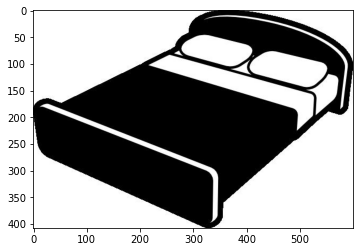

3 3 2
Bed Bed Batteries
0.99307215 0.99988365


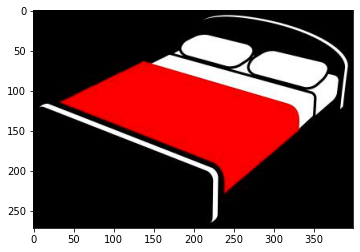

3 3 2
Bed Bed Batteries
0.9824689 0.9999838


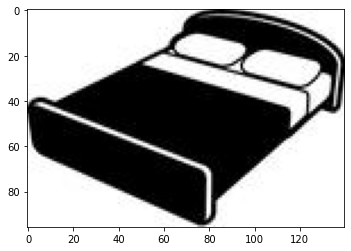

3 3 2
Bed Bed Batteries
0.9690308 0.99976724


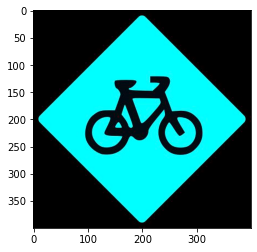

4 4 2
Bike Bike Batteries
0.99970466 0.9665212


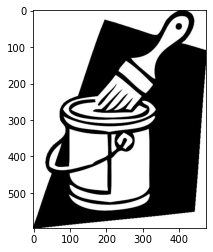

6 6 62
Bucket Bucket Trash_Can
0.99994403 0.99935865


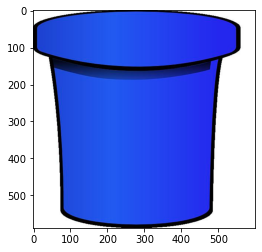

6 6 62
Bucket Bucket Trash_Can
0.62547296 0.9999998


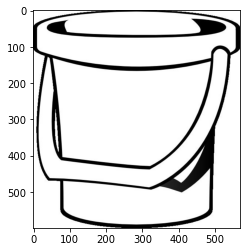

6 6 62
Bucket Bucket Trash_Can
0.9996138 0.9978395


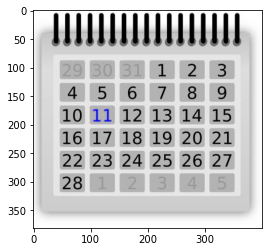

8 8 7
Calendar Calendar Calculator
0.9316085 0.8997203


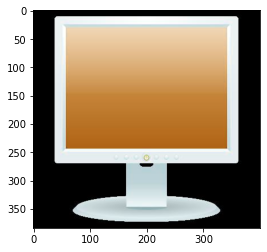

12 12 34
Computer Computer Monitor
0.9957903 0.57941896


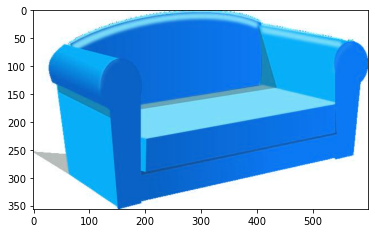

13 13 52
Couch Couch Shelf
0.94595116 0.8655787


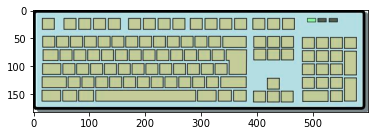

29 29 52
Keyboard Keyboard Shelf
0.99829555 0.9990442


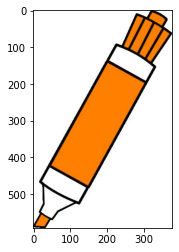

33 33 17
Marker Marker Eraser
0.9996185 0.9982141


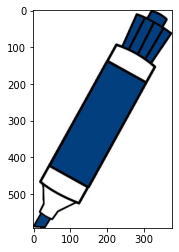

33 33 43
Marker Marker Pencil
0.99923366 0.878539


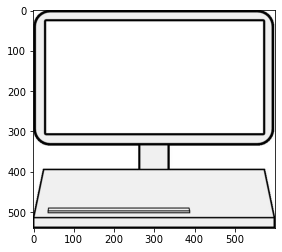

34 34 48
Monitor Monitor Refrigerator
0.9931706 0.62688315


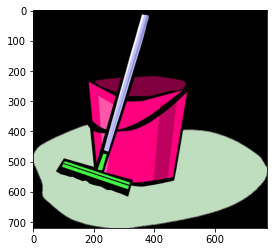

35 35 6
Mop Mop Bucket
0.9751547 0.99983495


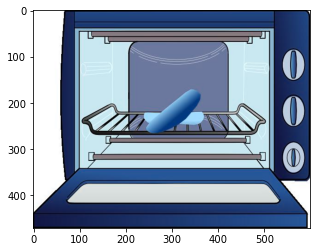

39 39 48
Oven Oven Refrigerator
0.99870723 0.9999892


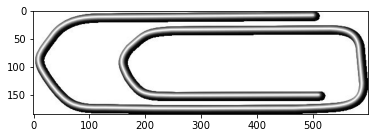

41 41 63
Paper_Clip Paper_Clip TV
0.98502594 0.998602


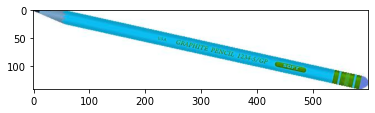

43 43 17
Pencil Pencil Eraser
0.9817636 0.94297695


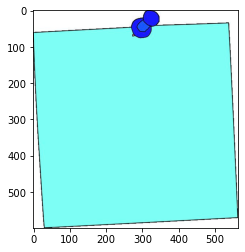

44 44 19
Postit_Notes Postit_Notes Fan
0.99971974 0.6377161


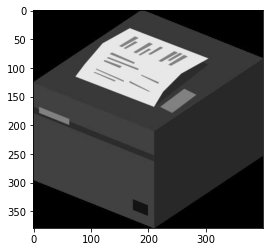

45 45 20
Printer Printer File_Cabinet
0.9902056 0.8995946


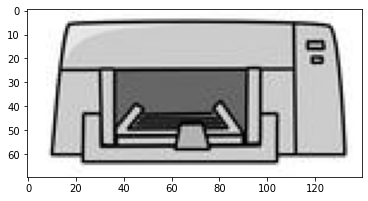

45 45 47
Printer Printer Radio
0.99837136 0.9508377


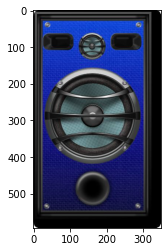

56 56 47
Speaker Speaker Radio
0.99580246 0.96169204


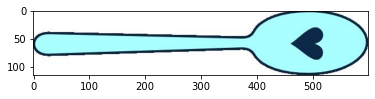

57 57 10
Spoon Spoon Chair
0.9965641 0.98523396


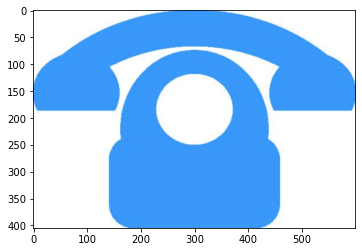

59 59 56
Telephone Telephone Speaker
0.99123484 0.9350651


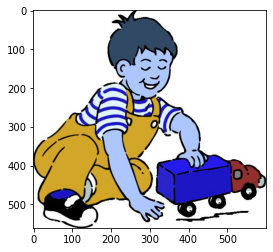

61 61 13
Toys Toys Couch
0.9971349 0.99472195


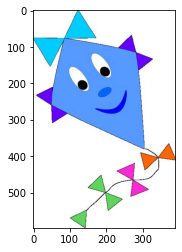

61 61 44
Toys Toys Postit_Notes
0.9976986 0.64169663


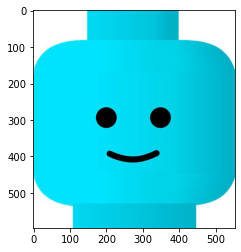

61 61 5
Toys Toys Bottle
0.998188 0.9999216


In [45]:
visualize_image_list(shot_win_list,txt_test,answer,shot_raw_predict,shot_predict,sdat_raw_predict,sdat_predict,class_map)

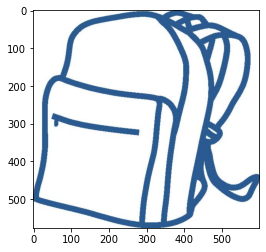

1 41 1
Backpack Paper_Clip Backpack
0.99955183 0.6818681


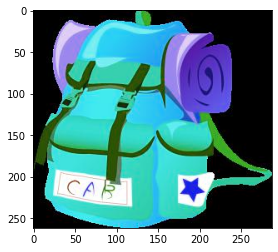

1 55 1
Backpack Soda Backpack
0.9977412 0.9576159


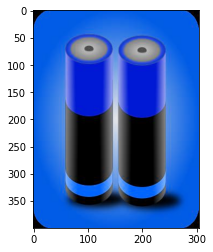

2 62 2
Batteries Trash_Can Batteries
0.9939136 0.99901277


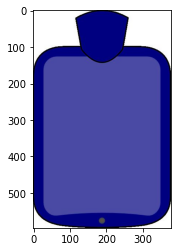

5 11 5
Bottle Clipboards Bottle
0.9230419 0.999997


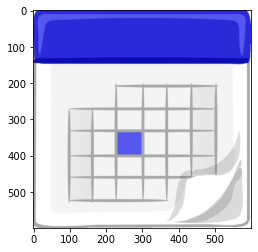

8 7 8
Calendar Calculator Calendar
0.9944502 0.9999991


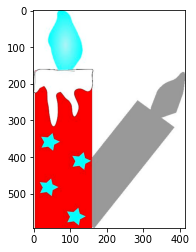

9 55 9
Candles Soda Candles
0.27993357 0.95235175


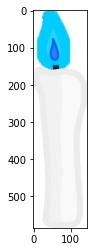

9 6 9
Candles Bucket Candles
0.90726 0.99996424


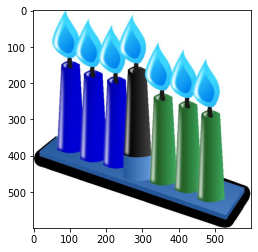

9 62 9
Candles Trash_Can Candles
0.9992574 0.9999814


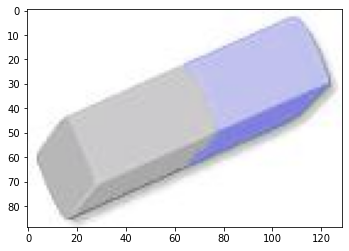

17 2 17
Eraser Batteries Eraser
0.97385967 0.99773496


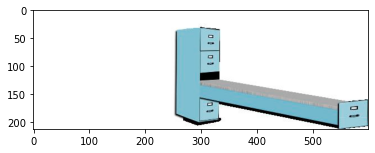

20 13 20
File_Cabinet Couch File_Cabinet
0.58548164 0.7636079


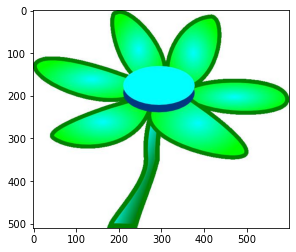

22 19 22
Flowers Fan Flowers
0.9990035 0.51407546


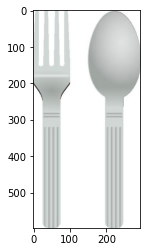

24 58 24
Fork Table Fork
0.9997811 0.9999999


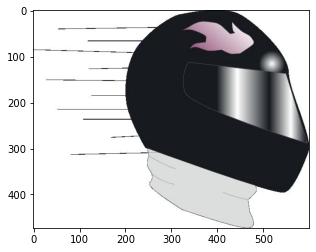

27 36 27
Helmet Mouse Helmet
0.90101284 0.9403249


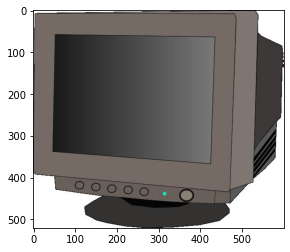

34 12 34
Monitor Computer Monitor
0.98802 0.9995643


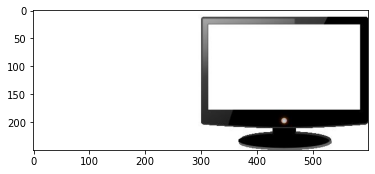

34 12 34
Monitor Computer Monitor
0.989033 0.877262


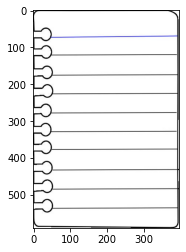

38 8 38
Notebook Calendar Notebook
0.9955608 0.7599874


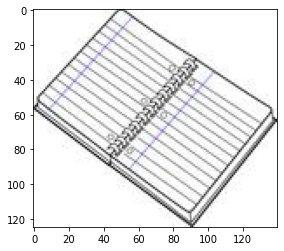

38 33 38
Notebook Marker Notebook
0.99506295 0.999995


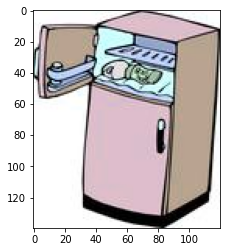

48 39 48
Refrigerator Oven Refrigerator
0.9903124 0.9998038


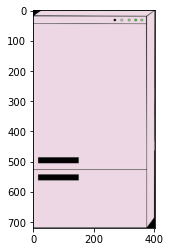

48 38 48
Refrigerator Notebook Refrigerator
0.99842846 0.9999714


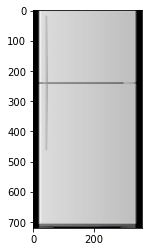

48 38 48
Refrigerator Notebook Refrigerator
0.96245396 1.0


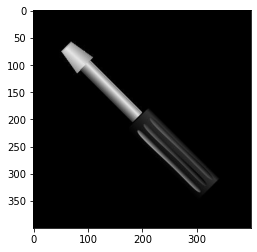

51 42 51
Screwdriver Pen Screwdriver
0.9902533 0.97608024


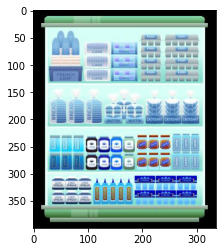

52 8 52
Shelf Calendar Shelf
0.5700304 0.999908


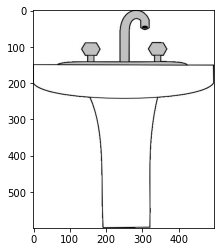

53 58 53
Sink Table Sink
0.9997086 0.9980975


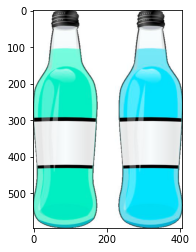

55 5 55
Soda Bottle Soda
0.9824462 0.98987037


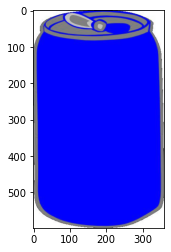

55 62 55
Soda Trash_Can Soda
0.97521436 0.9994175


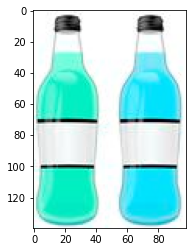

55 5 55
Soda Bottle Soda
0.9778794 0.9914557


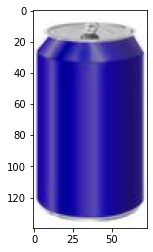

55 62 55
Soda Trash_Can Soda
0.99830586 0.9999618


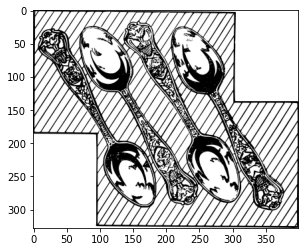

57 41 57
Spoon Paper_Clip Spoon
0.99953 0.9869621


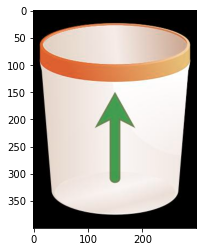

62 6 62
Trash_Can Bucket Trash_Can
0.99757034 0.61630744


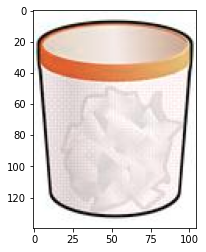

62 6 62
Trash_Can Bucket Trash_Can
0.9944793 0.99193764


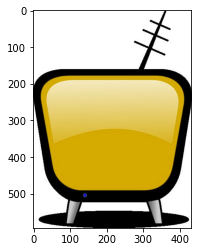

63 10 63
TV Chair TV
0.9658447 0.9982841


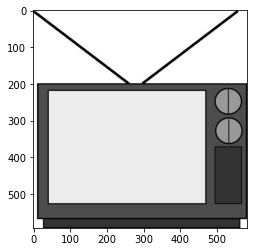

63 34 63
TV Monitor TV
0.98868513 0.711688


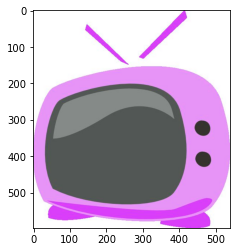

63 25 63
TV Glasses TV
0.9241667 0.999987


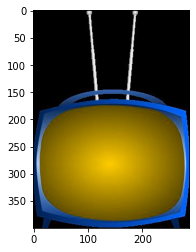

63 27 63
TV Helmet TV
0.99603605 0.9993163


In [49]:
visualize_image_list(sdat_win_list,txt_test,answer,shot_raw_predict,shot_predict,sdat_raw_predict,sdat_predict,class_map)

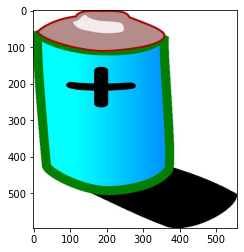

2 55 55
Batteries Soda Soda
0.995611 1.0


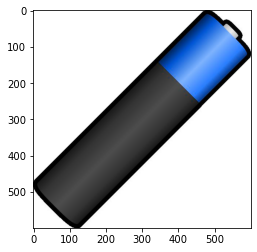

2 42 42
Batteries Pen Pen
0.92452025 0.72993493


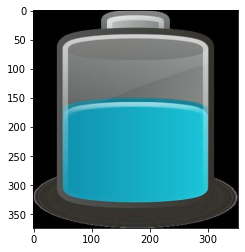

2 55 5
Batteries Soda Bottle
0.9992156 0.8108037


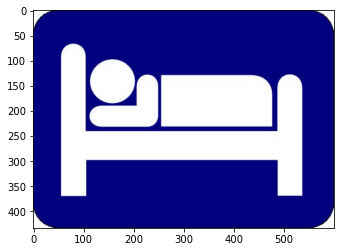

3 18 13
Bed Exit_Sign Couch
0.9522676 0.9656679


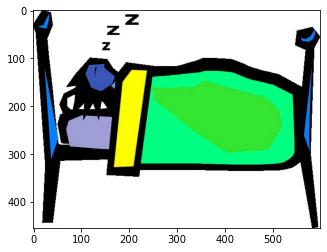

3 55 34
Bed Soda Monitor
0.8378493 0.4947089


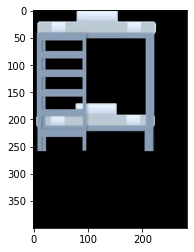

3 52 47
Bed Shelf Radio
0.9978156 0.8786812


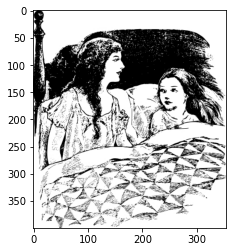

3 13 13
Bed Couch Couch
0.9990379 0.9282533


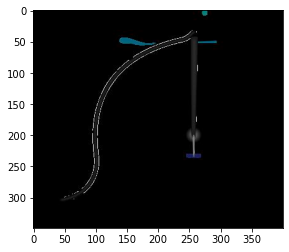

4 9 9
Bike Candles Candles
0.98490506 0.41810372


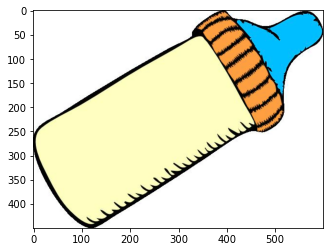

5 21 2
Bottle Flipflops Batteries
0.39479947 0.6337331


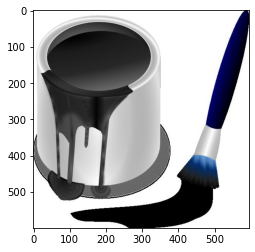

6 62 62
Bucket Trash_Can Trash_Can
0.99756134 0.9999799


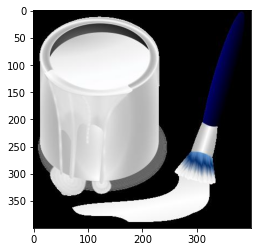

6 62 62
Bucket Trash_Can Trash_Can
0.99666435 0.9999245


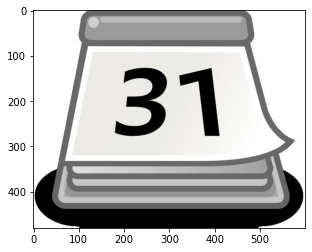

8 18 18
Calendar Exit_Sign Exit_Sign
0.98555005 0.99999416


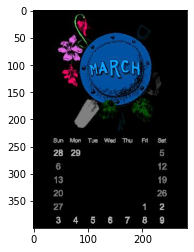

8 0 40
Calendar Alarm_Clock Pan
0.9923119 0.49859262


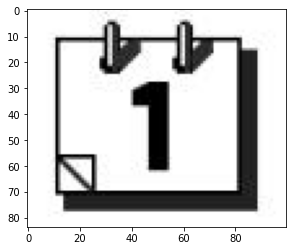

8 18 18
Calendar Exit_Sign Exit_Sign
0.99881387 0.99994665


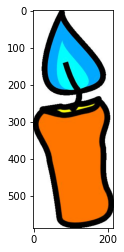

9 6 55
Candles Bucket Soda
0.95489115 0.57296485


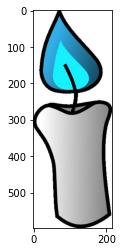

9 6 21
Candles Bucket Flipflops
0.9998343 0.8756404


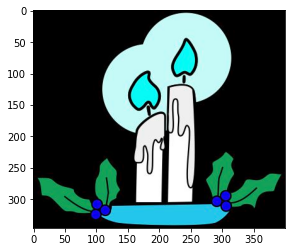

9 19 51
Candles Fan Screwdriver
0.99946874 0.97992533


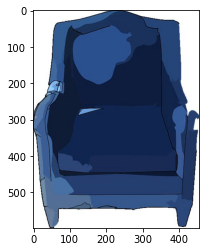

10 13 13
Chair Couch Couch
0.9979946 0.99992275


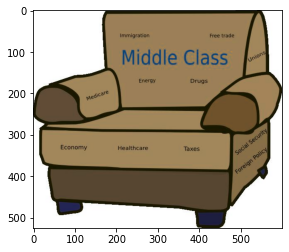

10 13 13
Chair Couch Couch
0.99962103 0.97254604


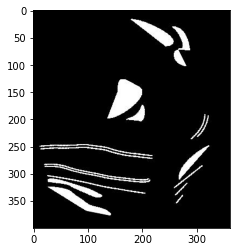

10 24 54
Chair Fork Sneakers
0.9691536 0.51944506


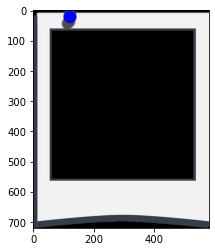

11 34 34
Clipboards Monitor Monitor
0.99980146 1.0


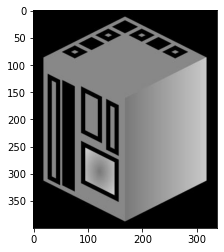

12 18 20
Computer Exit_Sign File_Cabinet
0.8863276 0.9999873


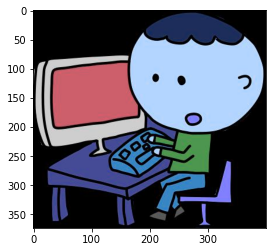

12 61 61
Computer Toys Toys
0.9408482 0.7032801


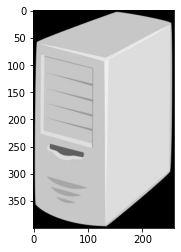

12 20 20
Computer File_Cabinet File_Cabinet
0.9995786 0.99999994


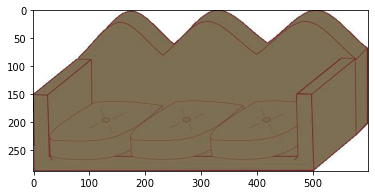

13 1 1
Couch Backpack Backpack
0.9843309 0.52963305


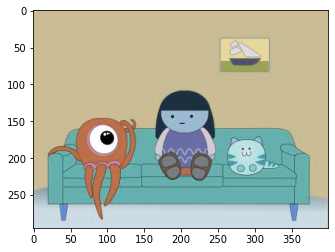

13 61 61
Couch Toys Toys
0.9997589 0.9973939


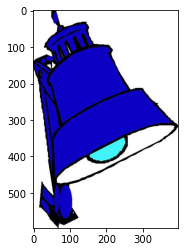

15 13 13
Desk_Lamp Couch Couch
0.9832196 0.9948191


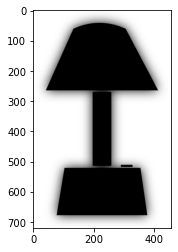

15 31 31
Desk_Lamp Lamp_Shade Lamp_Shade
0.99384105 0.9498281


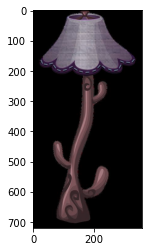

15 31 31
Desk_Lamp Lamp_Shade Lamp_Shade
0.952277 0.99721223


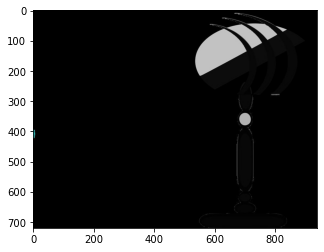

15 31 31
Desk_Lamp Lamp_Shade Lamp_Shade
0.99920976 0.9233067


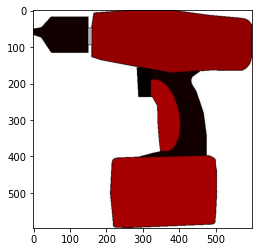

16 31 26
Drill Lamp_Shade Hammer
0.99113995 0.952296


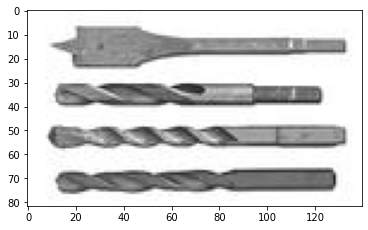

16 30 51
Drill Knives Screwdriver
0.95889235 0.9764227


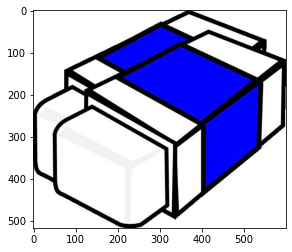

17 20 20
Eraser File_Cabinet File_Cabinet
0.9907135 0.9999886


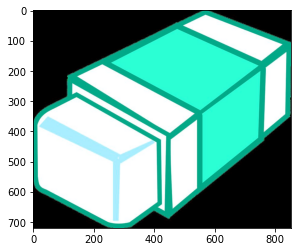

17 20 20
Eraser File_Cabinet File_Cabinet
0.9978852 0.9999878


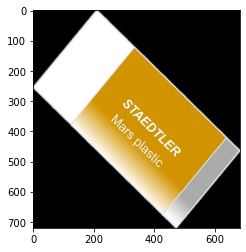

17 2 2
Eraser Batteries Batteries
0.999668 0.9999987


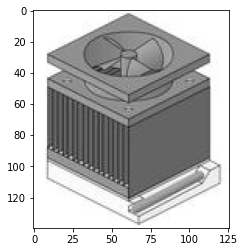

19 58 20
Fan Table File_Cabinet
0.99501073 0.7807464


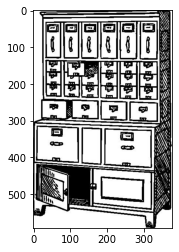

20 8 7
File_Cabinet Calendar Calculator
0.92488956 0.9162562


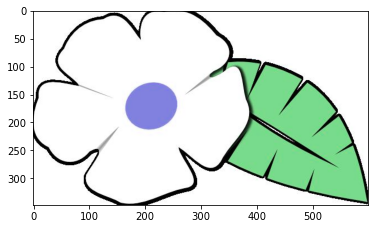

22 19 19
Flowers Fan Fan
0.98897386 0.3385868


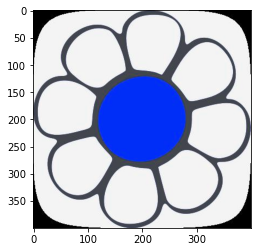

22 25 25
Flowers Glasses Glasses
0.9139577 0.9338681


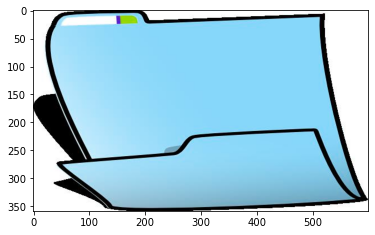

23 11 11
Folder Clipboards Clipboards
0.9929682 0.96702224


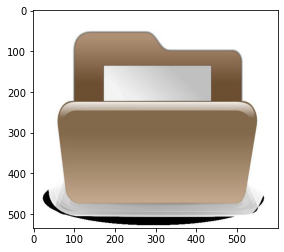

23 45 45
Folder Printer Printer
0.9955324 0.9898044


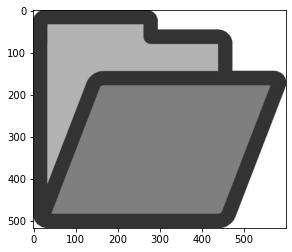

23 11 11
Folder Clipboards Clipboards
0.8826923 0.9998625


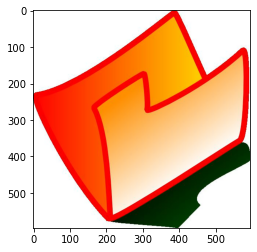

23 18 54
Folder Exit_Sign Sneakers
0.9445165 0.9220177


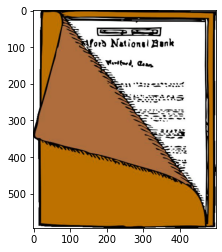

23 31 38
Folder Lamp_Shade Notebook
0.8990033 0.23942435


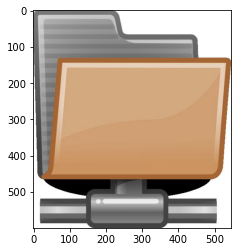

23 34 34
Folder Monitor Monitor
0.9769426 0.9802708


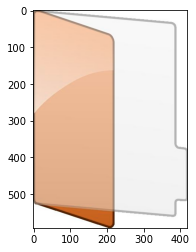

23 11 38
Folder Clipboards Notebook
0.8017545 0.5565924


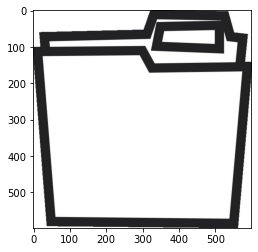

23 18 11
Folder Exit_Sign Clipboards
0.9603407 0.94258976


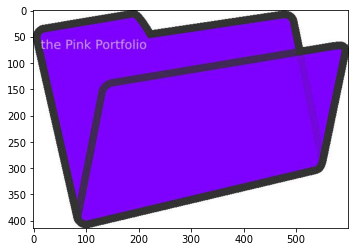

23 11 38
Folder Clipboards Notebook
0.98007315 0.57463837


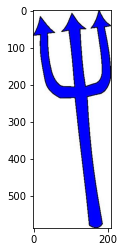

24 41 41
Fork Paper_Clip Paper_Clip
0.99845487 0.9986213


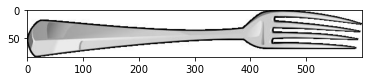

24 57 30
Fork Spoon Knives
0.95769995 0.5010632


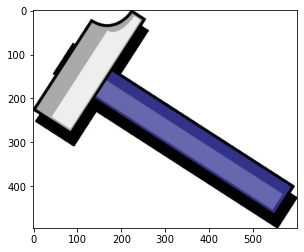

26 30 30
Hammer Knives Knives
0.9853717 0.99995303


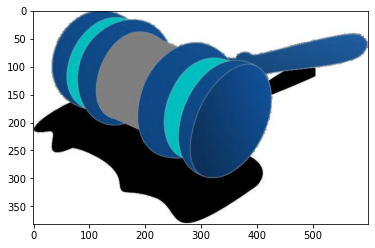

26 16 19
Hammer Drill Fan
0.99303603 0.76050055


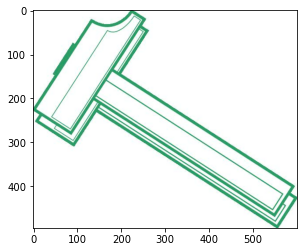

26 41 41
Hammer Paper_Clip Paper_Clip
0.99992806 0.7149256


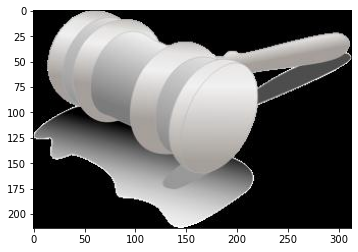

26 16 19
Hammer Drill Fan
0.992155 0.99994


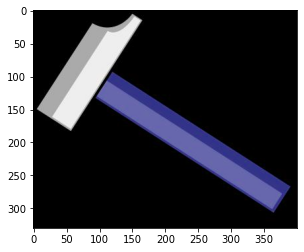

26 30 30
Hammer Knives Knives
0.99815863 1.0


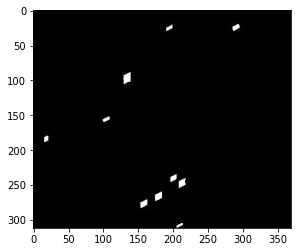

27 9 9
Helmet Candles Candles
0.9998768 0.99998146


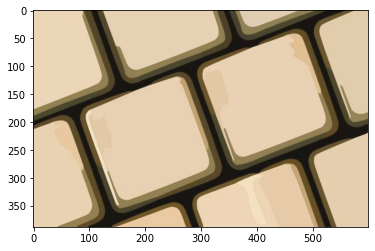

29 63 63
Keyboard TV TV
0.9206042 0.98101425


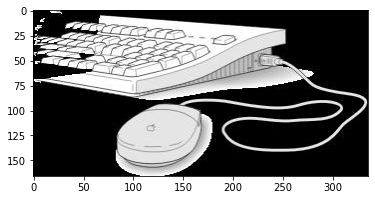

29 32 32
Keyboard Laptop Laptop
0.92068183 0.39309454


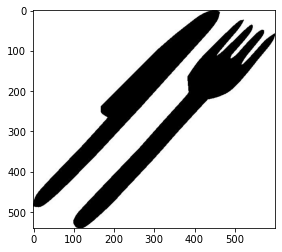

30 24 24
Knives Fork Fork
0.99205965 0.9999811


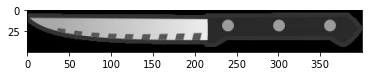

30 24 18
Knives Fork Exit_Sign
0.9664216 0.99775743


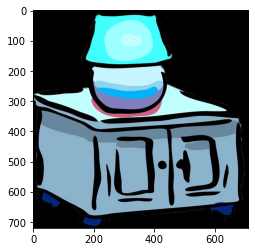

31 55 9
Lamp_Shade Soda Candles
0.99446243 0.88717306


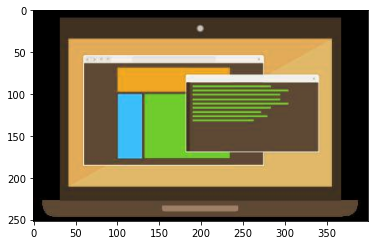

32 34 47
Laptop Monitor Radio
0.9941544 0.67862356


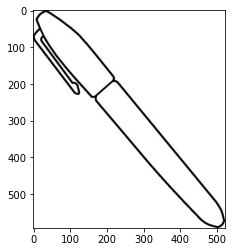

33 30 30
Marker Knives Knives
0.8971531 0.9999992


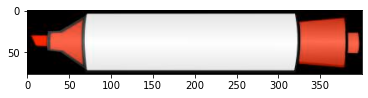

33 38 11
Marker Notebook Clipboards
0.794414 0.7984754


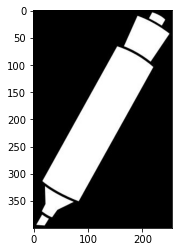

33 30 30
Marker Knives Knives
0.58542705 0.99990416


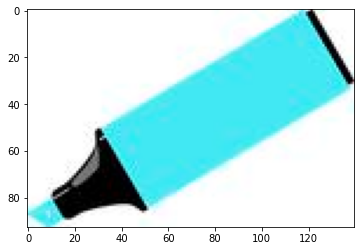

33 2 17
Marker Batteries Eraser
0.9980894 0.7342568


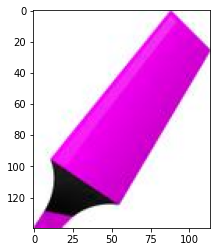

33 2 17
Marker Batteries Eraser
0.99829876 0.9995851


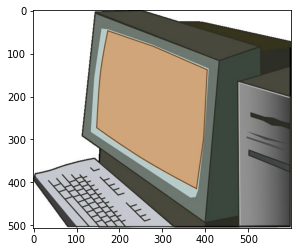

34 12 12
Monitor Computer Computer
0.99611807 0.7889665


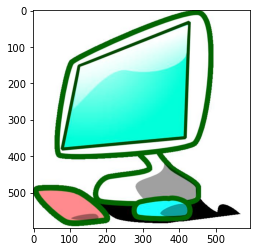

34 12 63
Monitor Computer TV
0.99956954 0.4788831


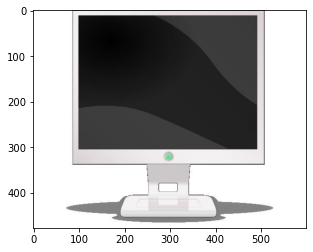

34 12 12
Monitor Computer Computer
0.99942106 0.9170648


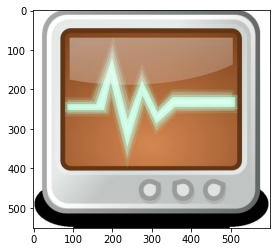

34 18 63
Monitor Exit_Sign TV
0.8596534 0.7005131


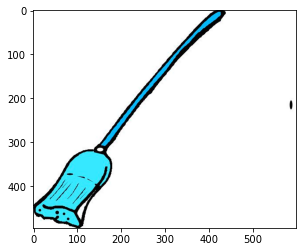

35 51 51
Mop Screwdriver Screwdriver
0.921844 0.99970794


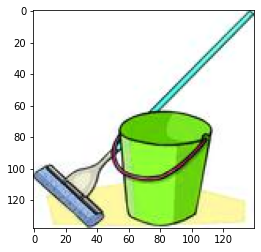

35 6 6
Mop Bucket Bucket
0.9959459 0.99996716


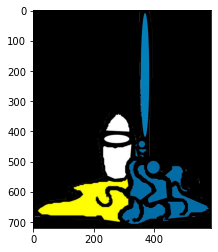

35 9 9
Mop Candles Candles
0.9975144 0.9999997


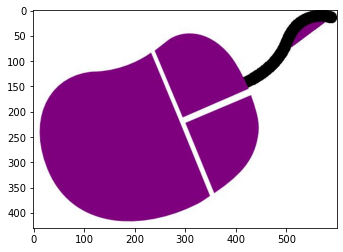

36 21 1
Mouse Flipflops Backpack
0.9827466 0.75764245


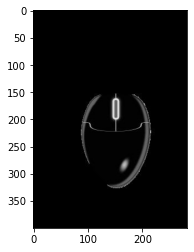

36 9 9
Mouse Candles Candles
0.9810197 0.98200125


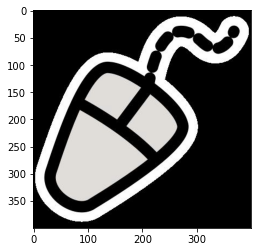

36 41 41
Mouse Paper_Clip Paper_Clip
0.9997296 0.9999862


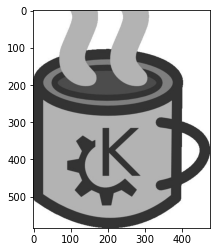

37 55 18
Mug Soda Exit_Sign
0.99342096 0.94634336


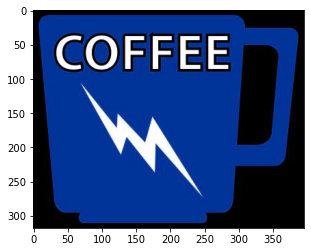

37 18 18
Mug Exit_Sign Exit_Sign
0.97657984 1.0


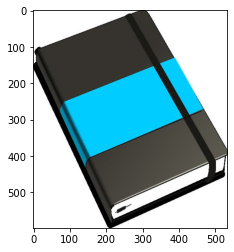

38 2 2
Notebook Batteries Batteries
0.9471611 0.99999845


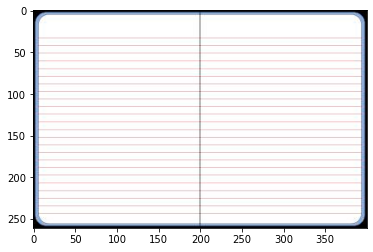

38 8 8
Notebook Calendar Calendar
0.9949546 0.96423817


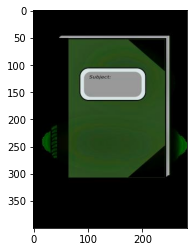

38 48 23
Notebook Refrigerator Folder
0.9696072 1.0


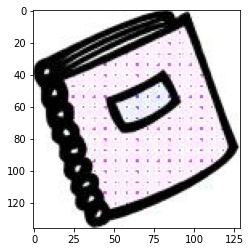

38 41 0
Notebook Paper_Clip Alarm_Clock
0.98748934 0.9072354


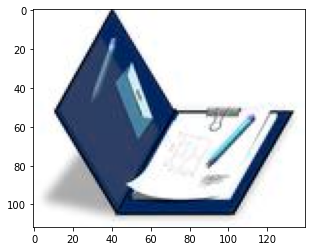

38 11 11
Notebook Clipboards Clipboards
0.98981744 0.9976019


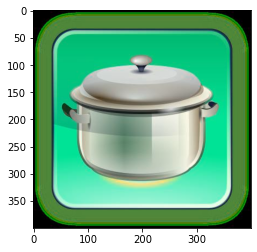

40 6 28
Pan Bucket Kettle
0.92860866 0.9971509


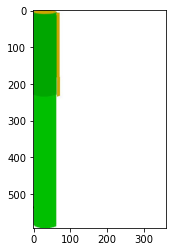

42 38 38
Pen Notebook Notebook
0.9976689 0.96725225


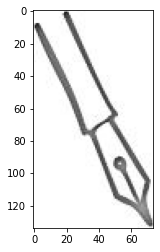

42 30 30
Pen Knives Knives
0.9757072 0.9847166


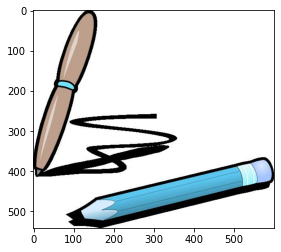

43 42 42
Pencil Pen Pen
0.99798185 0.9999997


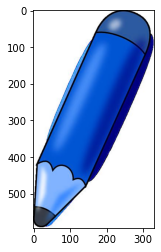

43 2 2
Pencil Batteries Batteries
0.9903834 0.4254873


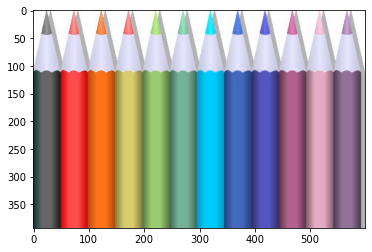

43 14 14
Pencil Curtains Curtains
0.99913484 0.6913969


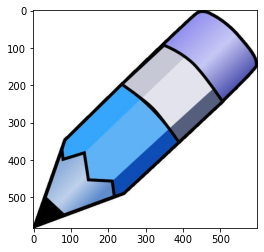

43 33 17
Pencil Marker Eraser
0.99885833 0.9913426


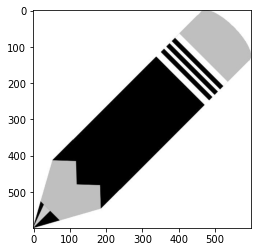

43 33 2
Pencil Marker Batteries
0.9378133 0.69857264


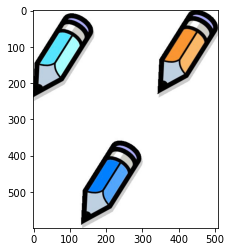

43 33 51
Pencil Marker Screwdriver
0.998877 0.9998577


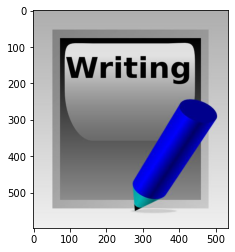

43 2 2
Pencil Batteries Batteries
0.9086112 0.7416549


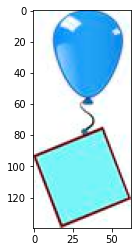

44 40 57
Postit_Notes Pan Spoon
0.986945 0.8491248


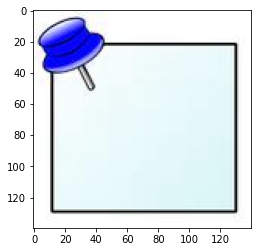

44 46 46
Postit_Notes Push_Pin Push_Pin
0.997315 0.9999987


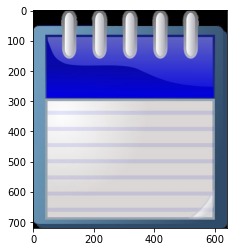

44 46 41
Postit_Notes Push_Pin Paper_Clip
0.9748334 0.3843986


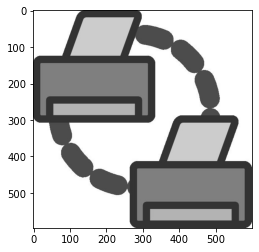

45 47 47
Printer Radio Radio
0.6401241 0.9956318


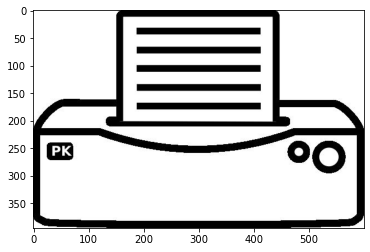

45 24 47
Printer Fork Radio
0.9744713 0.9998777


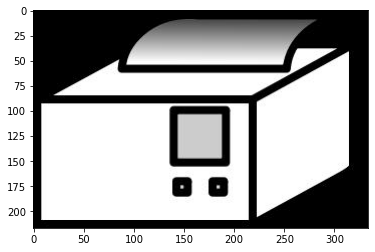

45 18 20
Printer Exit_Sign File_Cabinet
0.98606557 0.9985031


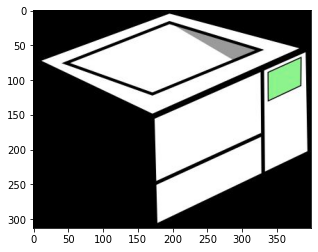

45 20 20
Printer File_Cabinet File_Cabinet
0.93446857 0.9999682


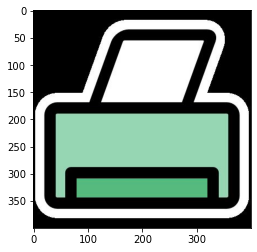

45 18 47
Printer Exit_Sign Radio
0.99282175 0.9995762


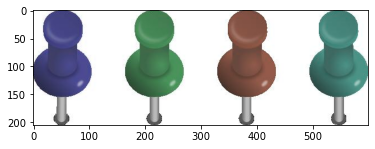

46 5 57
Push_Pin Bottle Spoon
0.55642635 0.9763268


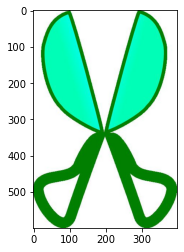

50 19 22
Scissors Fan Flowers
0.9951554 0.999706


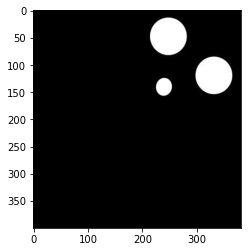

50 9 9
Scissors Candles Candles
0.97459376 0.99990714


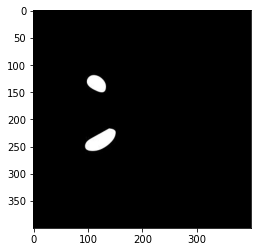

50 9 9
Scissors Candles Candles
0.99119216 0.9999899


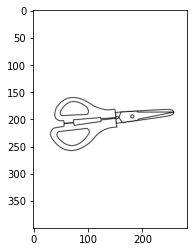

50 57 57
Scissors Spoon Spoon
0.9985106 0.84374565


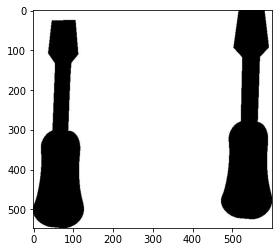

51 26 26
Screwdriver Hammer Hammer
0.75173974 0.9969787


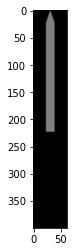

51 14 26
Screwdriver Curtains Hammer
0.9878796 0.8147431


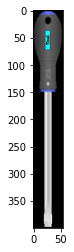

51 26 26
Screwdriver Hammer Hammer
0.99901396 0.9994387


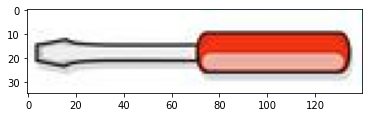

51 2 26
Screwdriver Batteries Hammer
0.9598078 0.8231006


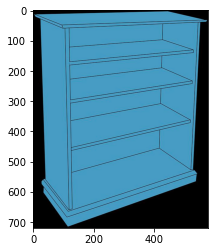

52 20 20
Shelf File_Cabinet File_Cabinet
0.9973274 0.9999973


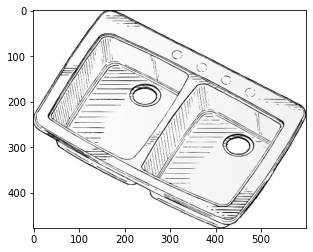

53 47 47
Sink Radio Radio
0.99522686 0.99851626


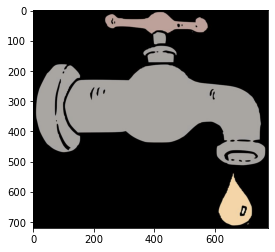

53 5 28
Sink Bottle Kettle
0.98098695 0.7209587


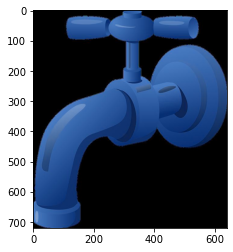

53 46 26
Sink Push_Pin Hammer
0.9819255 0.5019289


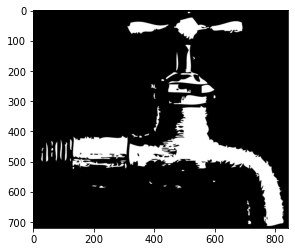

53 5 5
Sink Bottle Bottle
0.95021516 0.9046443


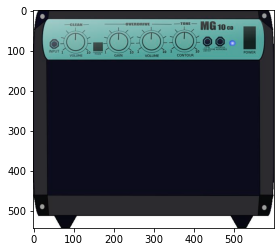

56 39 39
Speaker Oven Oven
0.9976445 0.73623174


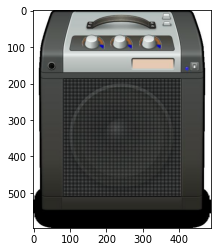

56 47 47
Speaker Radio Radio
0.9922334 0.9983722


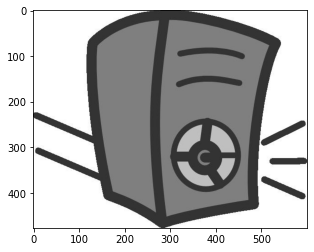

56 24 1
Speaker Fork Backpack
0.85885584 0.47001046


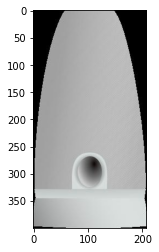

56 64 31
Speaker Webcam Lamp_Shade
0.9973697 0.8025611


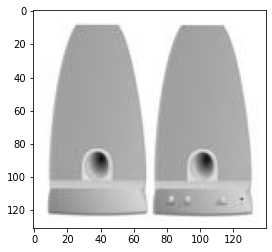

56 64 47
Speaker Webcam Radio
0.71203005 0.9044332


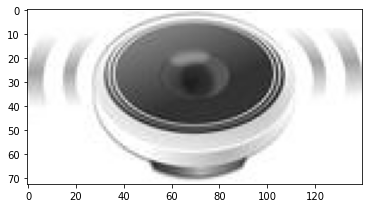

56 64 64
Speaker Webcam Webcam
0.9999816 0.9999975


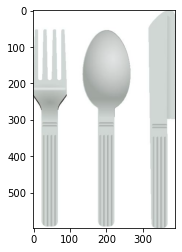

57 58 24
Spoon Table Fork
0.9094678 0.9999065


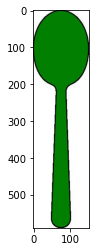

57 26 26
Spoon Hammer Hammer
0.9997523 0.9997073


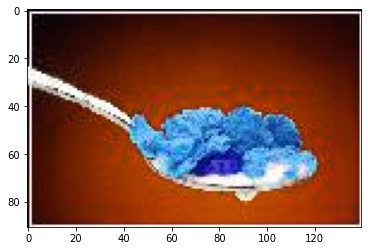

57 40 40
Spoon Pan Pan
0.99432105 0.59531015


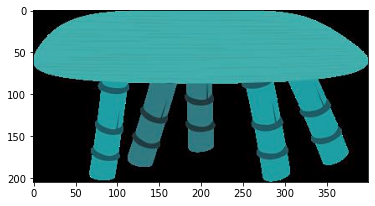

58 31 31
Table Lamp_Shade Lamp_Shade
0.9965222 0.99997044


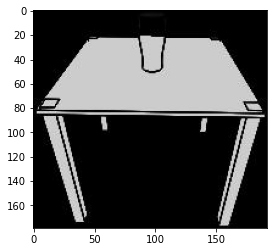

58 31 31
Table Lamp_Shade Lamp_Shade
0.954094 0.413676


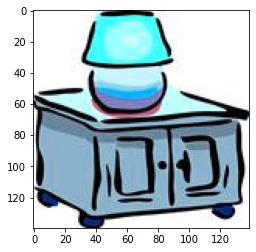

58 55 15
Table Soda Desk_Lamp
0.964333 0.8320939


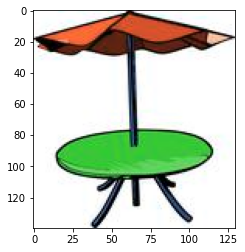

58 31 31
Table Lamp_Shade Lamp_Shade
0.98394024 0.9670658


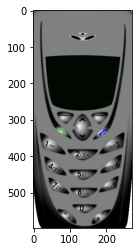

59 7 7
Telephone Calculator Calculator
0.9949385 0.99923325


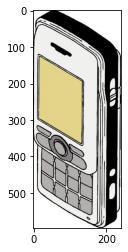

59 63 63
Telephone TV TV
0.9569522 0.8347519


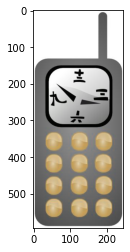

59 7 7
Telephone Calculator Calculator
0.9945395 0.9998883


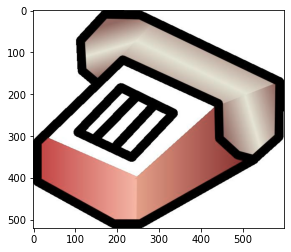

59 24 24
Telephone Fork Fork
0.98287654 0.76998824


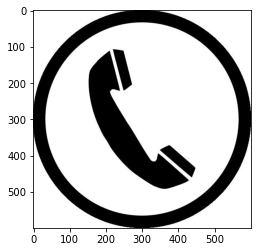

59 0 0
Telephone Alarm_Clock Alarm_Clock
0.7619384 0.99674803


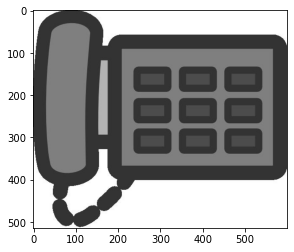

59 7 7
Telephone Calculator Calculator
0.99729913 0.9999493


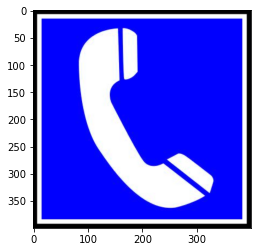

59 24 41
Telephone Fork Paper_Clip
0.9873056 0.96359694


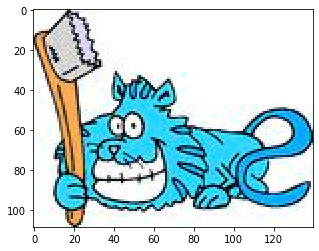

60 22 35
ToothBrush Flowers Mop
0.84708685 0.175384


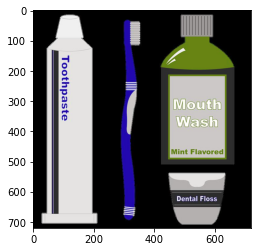

60 5 5
ToothBrush Bottle Bottle
0.988812 0.9973367


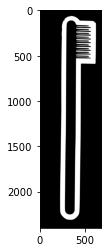

60 24 24
ToothBrush Fork Fork
0.999383 0.99996656


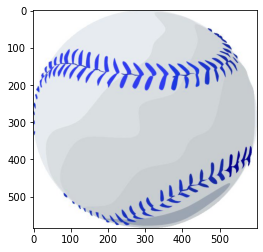

61 54 24
Toys Sneakers Fork
0.9061165 0.74440855


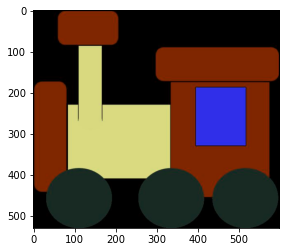

61 40 40
Toys Pan Pan
0.9965228 0.998895


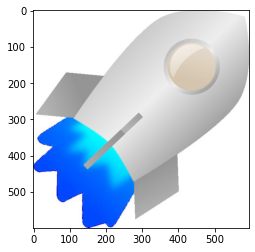

61 30 30
Toys Knives Knives
0.9792802 0.58456624


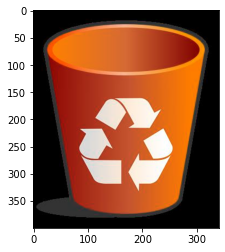

62 55 55
Trash_Can Soda Soda
0.8434301 0.9825686


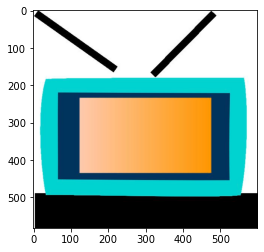

63 34 34
TV Monitor Monitor
0.99668556 0.82380366


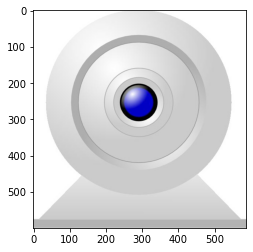

64 56 56
Webcam Speaker Speaker
0.9971188 0.97627425


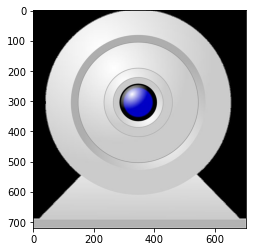

64 56 56
Webcam Speaker Speaker
0.9934535 0.90262103


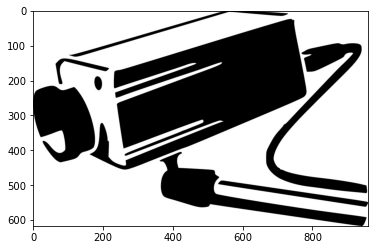

64 45 16
Webcam Printer Drill
0.7128569 0.98176193


In [47]:
visualize_image_list(both_fail_list,txt_test,answer,shot_raw_predict,shot_predict,sdat_raw_predict,sdat_predict,class_map)

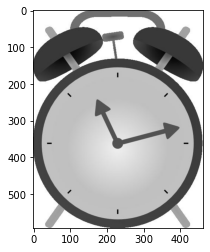

0 0 0
Alarm_Clock Alarm_Clock Alarm_Clock
0.99512 0.99999994


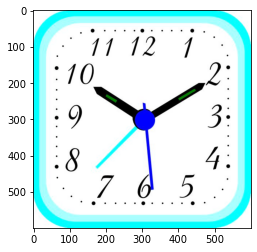

0 0 0
Alarm_Clock Alarm_Clock Alarm_Clock
0.9993602 1.0


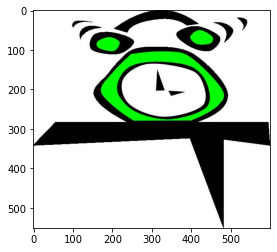

0 0 0
Alarm_Clock Alarm_Clock Alarm_Clock
0.9976327 0.999997


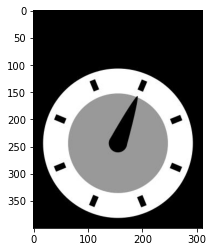

0 0 0
Alarm_Clock Alarm_Clock Alarm_Clock
0.9929243 0.9999992


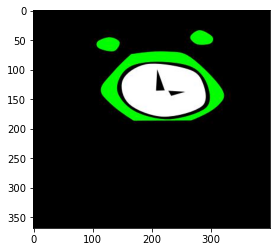

0 0 0
Alarm_Clock Alarm_Clock Alarm_Clock
0.99984956 1.0


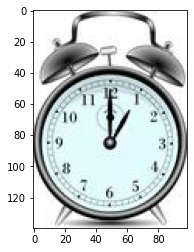

0 0 0
Alarm_Clock Alarm_Clock Alarm_Clock
0.99918485 0.99999994


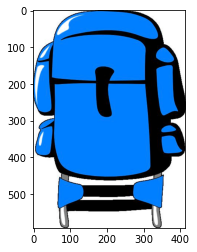

1 1 1
Backpack Backpack Backpack
0.9929058 0.9999698


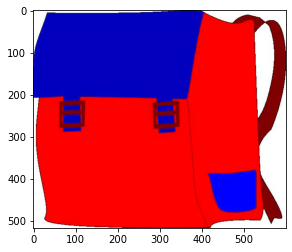

1 1 1
Backpack Backpack Backpack
0.9996629 0.99935126


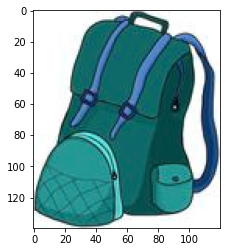

1 1 1
Backpack Backpack Backpack
0.9995006 0.9999994


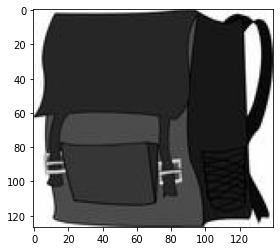

1 1 1
Backpack Backpack Backpack
0.9961871 0.9844618


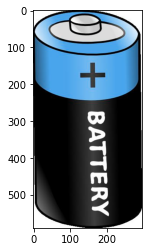

2 2 2
Batteries Batteries Batteries
0.49700478 0.99998903


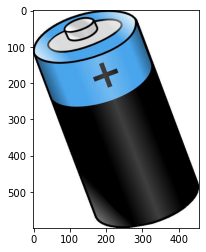

2 2 2
Batteries Batteries Batteries
0.7775264 0.9998379


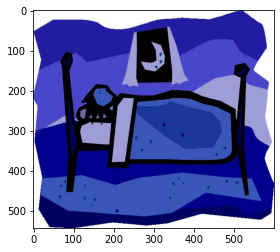

3 3 3
Bed Bed Bed
0.99462515 0.9810989


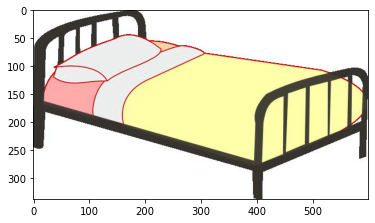

3 3 3
Bed Bed Bed
0.99724925 1.0


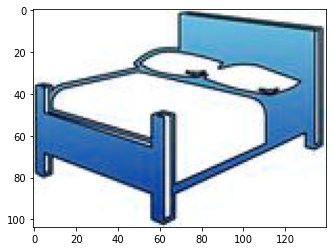

3 3 3
Bed Bed Bed
0.9742149 0.9981599


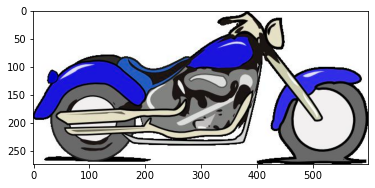

4 4 4
Bike Bike Bike
0.9934283 0.87890804


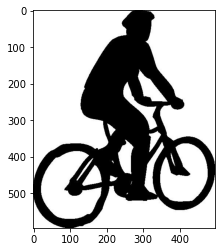

4 4 4
Bike Bike Bike
0.9998662 1.0


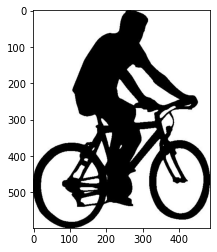

4 4 4
Bike Bike Bike
0.9998445 1.0


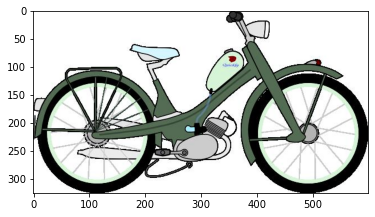

4 4 4
Bike Bike Bike
0.9997636 1.0


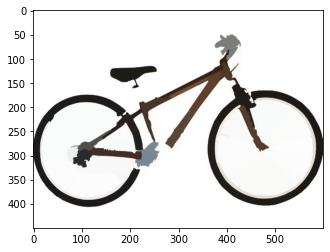

4 4 4
Bike Bike Bike
0.99808645 0.99999905


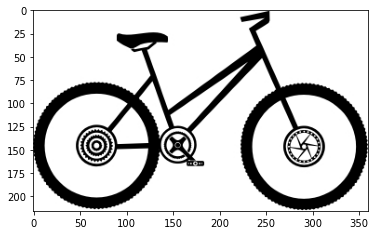

4 4 4
Bike Bike Bike
0.99961424 1.0


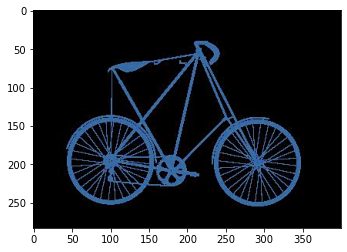

4 4 4
Bike Bike Bike
0.99746996 0.9999998


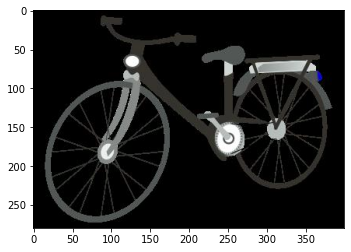

4 4 4
Bike Bike Bike
0.999054 0.99999946


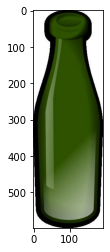

5 5 5
Bottle Bottle Bottle
0.99535376 0.99999285


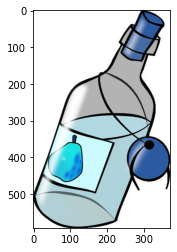

5 5 5
Bottle Bottle Bottle
0.9944958 0.992086


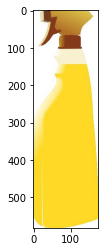

5 5 5
Bottle Bottle Bottle
0.9994907 0.99987036


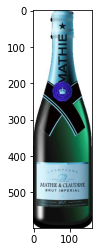

5 5 5
Bottle Bottle Bottle
0.98131925 0.98237133


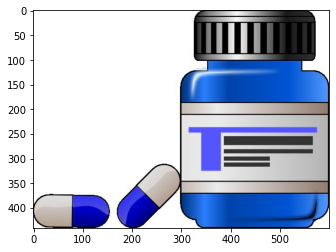

5 5 5
Bottle Bottle Bottle
0.97478026 0.98366654


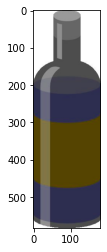

5 5 5
Bottle Bottle Bottle
0.98884207 0.99998933


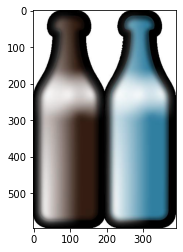

5 5 5
Bottle Bottle Bottle
0.99786764 0.999971


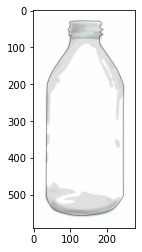

5 5 5
Bottle Bottle Bottle
0.9988355 1.0


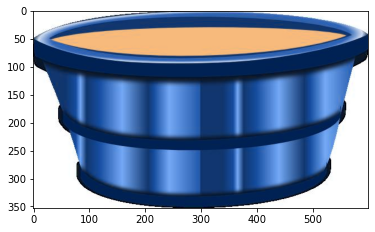

6 6 6
Bucket Bucket Bucket
0.9982443 0.9726247


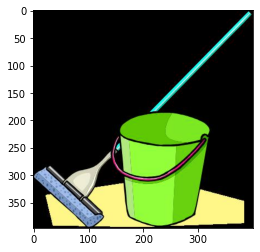

6 6 6
Bucket Bucket Bucket
0.9972819 0.9999811


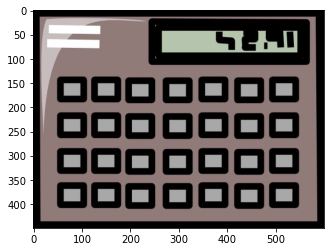

7 7 7
Calculator Calculator Calculator
0.9980377 0.99999696


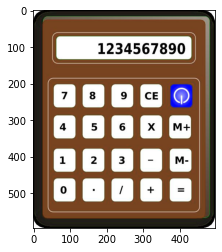

7 7 7
Calculator Calculator Calculator
0.9722478 0.9998875


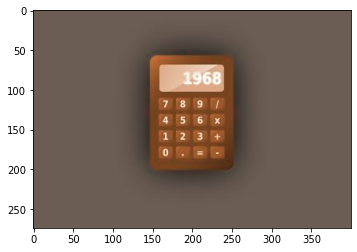

7 7 7
Calculator Calculator Calculator
0.9980792 0.9999633


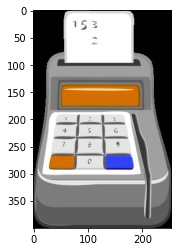

7 7 7
Calculator Calculator Calculator
0.96904075 0.9999742


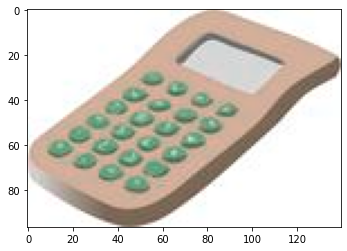

7 7 7
Calculator Calculator Calculator
0.99684393 0.99999946


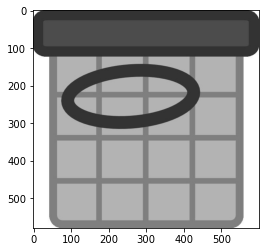

8 8 8
Calendar Calendar Calendar
0.99542075 0.8473794


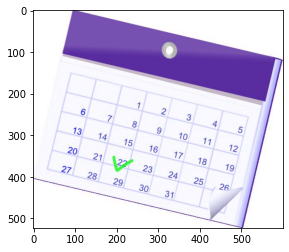

8 8 8
Calendar Calendar Calendar
0.99780613 0.9999975


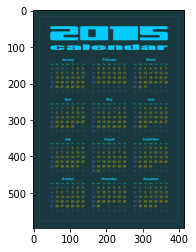

8 8 8
Calendar Calendar Calendar
0.9864988 0.9999878


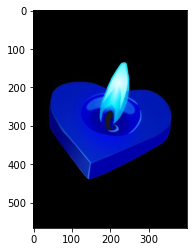

9 9 9
Candles Candles Candles
0.9934256 1.0


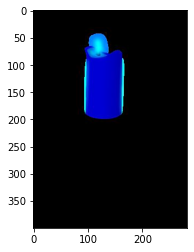

9 9 9
Candles Candles Candles
0.8009936 1.0


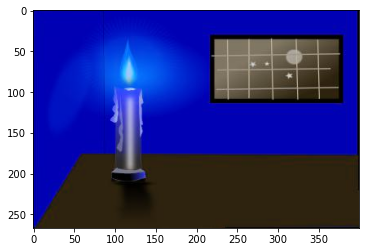

9 9 9
Candles Candles Candles
0.9969565 0.9999855


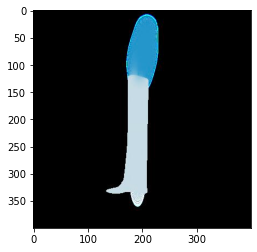

9 9 9
Candles Candles Candles
0.9842577 0.99999404


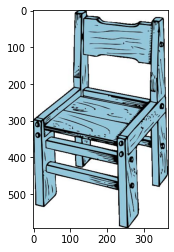

10 10 10
Chair Chair Chair
0.98728985 0.99878335


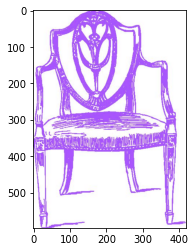

10 10 10
Chair Chair Chair
0.99453855 0.9993678


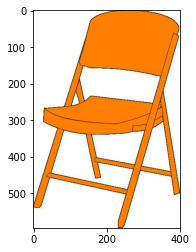

10 10 10
Chair Chair Chair
0.9908309 1.0


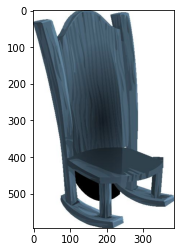

10 10 10
Chair Chair Chair
0.98654044 0.99990934


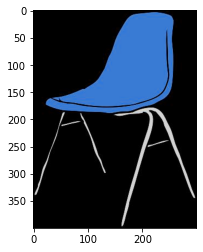

10 10 10
Chair Chair Chair
0.99926805 0.99985504


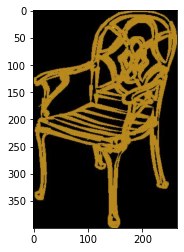

10 10 10
Chair Chair Chair
0.9982349 0.9999969


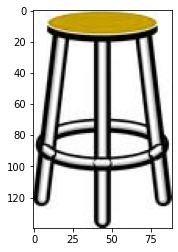

10 10 10
Chair Chair Chair
0.9920028 0.9999588


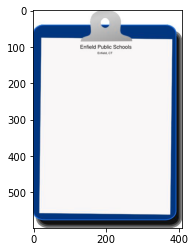

11 11 11
Clipboards Clipboards Clipboards
0.99986607 0.9999929


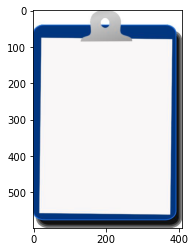

11 11 11
Clipboards Clipboards Clipboards
0.9996469 0.9999998


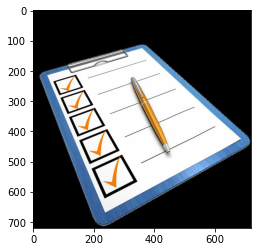

11 11 11
Clipboards Clipboards Clipboards
0.965664 0.88527155


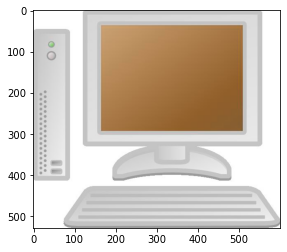

12 12 12
Computer Computer Computer
0.9998245 0.811598


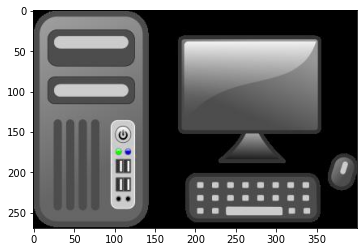

12 12 12
Computer Computer Computer
0.91475725 0.54709184


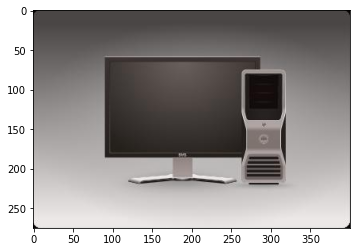

12 12 12
Computer Computer Computer
0.9986937 0.83903974


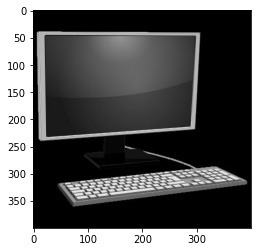

12 12 12
Computer Computer Computer
0.9996885 0.9478887


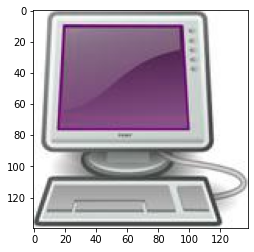

12 12 12
Computer Computer Computer
0.99736714 0.9475144


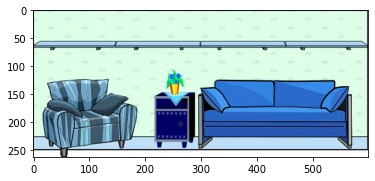

13 13 13
Couch Couch Couch
0.99878794 0.9977856


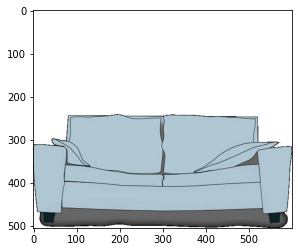

13 13 13
Couch Couch Couch
0.9988879 0.9999866


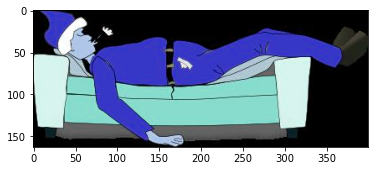

13 13 13
Couch Couch Couch
0.48678702 0.9992515


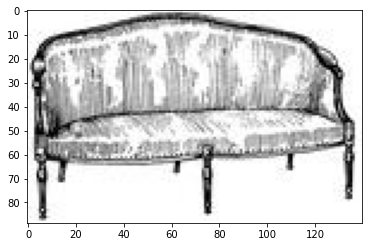

13 13 13
Couch Couch Couch
0.9769179 0.9998809


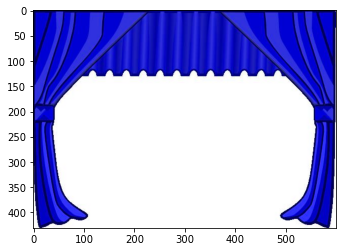

14 14 14
Curtains Curtains Curtains
0.9956685 0.99999994


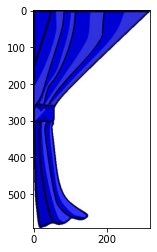

14 14 14
Curtains Curtains Curtains
0.9795415 0.9999968


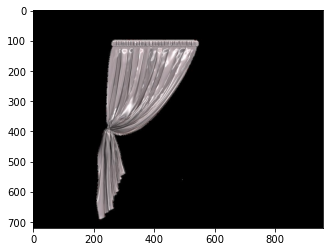

14 14 14
Curtains Curtains Curtains
0.9963105 0.99999964


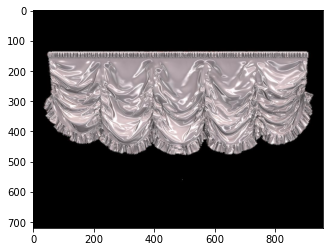

14 14 14
Curtains Curtains Curtains
0.9837788 0.99999785


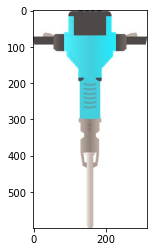

16 16 16
Drill Drill Drill
0.9329877 0.999999


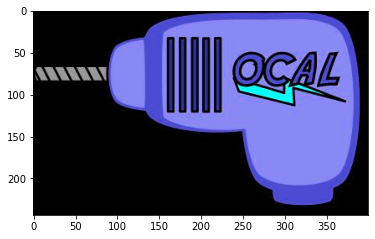

16 16 16
Drill Drill Drill
0.99868774 0.5514428


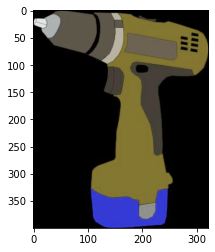

16 16 16
Drill Drill Drill
0.9825371 0.9999884


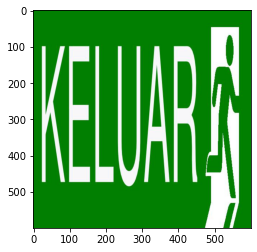

18 18 18
Exit_Sign Exit_Sign Exit_Sign
0.9914588 1.0


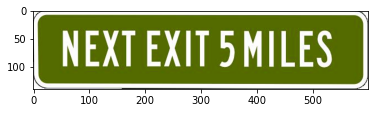

18 18 18
Exit_Sign Exit_Sign Exit_Sign
0.9878712 1.0


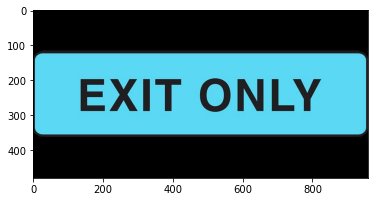

18 18 18
Exit_Sign Exit_Sign Exit_Sign
0.9952581 1.0


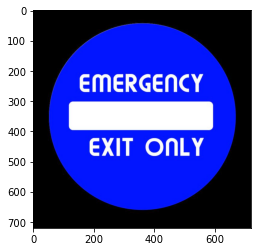

18 18 18
Exit_Sign Exit_Sign Exit_Sign
0.9879525 0.9998977


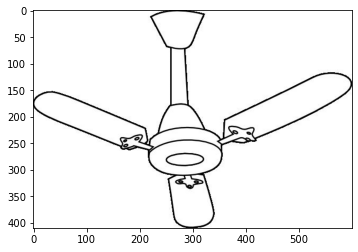

19 19 19
Fan Fan Fan
0.9987909 1.0


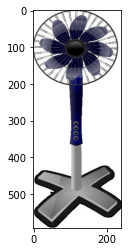

19 19 19
Fan Fan Fan
0.97907895 0.9999954


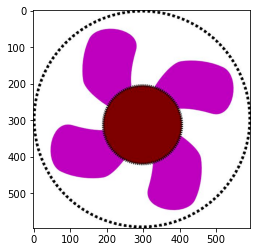

19 19 19
Fan Fan Fan
0.9980855 1.0


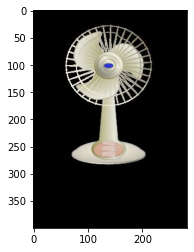

19 19 19
Fan Fan Fan
0.99777144 0.9999994


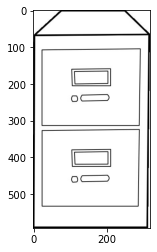

20 20 20
File_Cabinet File_Cabinet File_Cabinet
0.9949902 0.9999996


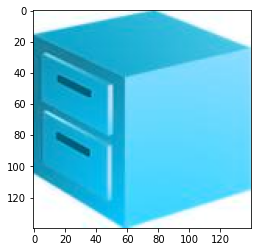

20 20 20
File_Cabinet File_Cabinet File_Cabinet
0.96997035 0.9999994


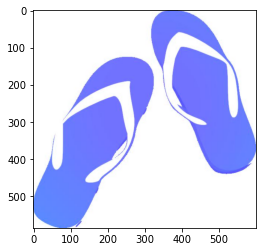

21 21 21
Flipflops Flipflops Flipflops
0.9893116 0.99999785


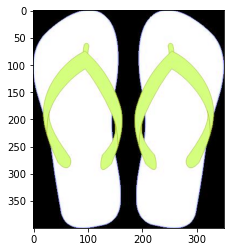

21 21 21
Flipflops Flipflops Flipflops
0.9953724 0.99999964


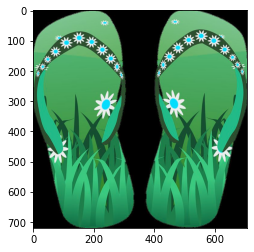

21 21 21
Flipflops Flipflops Flipflops
0.9825928 0.99999934


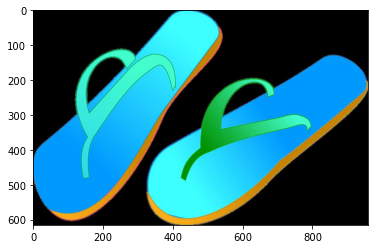

21 21 21
Flipflops Flipflops Flipflops
0.99247646 0.9998909


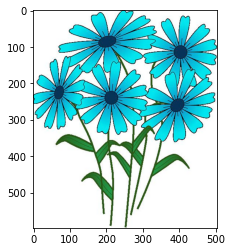

22 22 22
Flowers Flowers Flowers
0.9972719 1.0


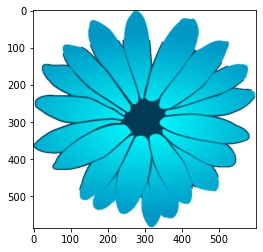

22 22 22
Flowers Flowers Flowers
0.9963966 1.0


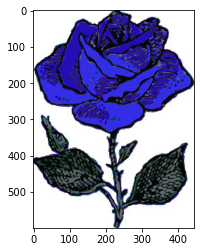

22 22 22
Flowers Flowers Flowers
0.9490193 0.99986523


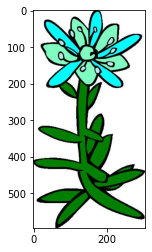

22 22 22
Flowers Flowers Flowers
0.9905832 1.0


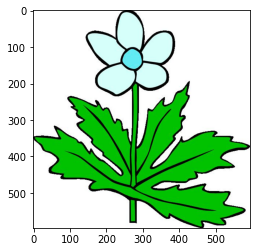

22 22 22
Flowers Flowers Flowers
0.9996101 1.0


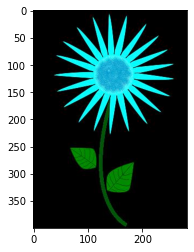

22 22 22
Flowers Flowers Flowers
0.9902077 0.9999907


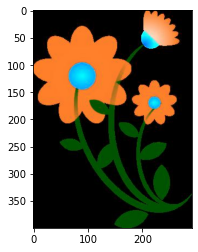

22 22 22
Flowers Flowers Flowers
0.9969759 0.999992


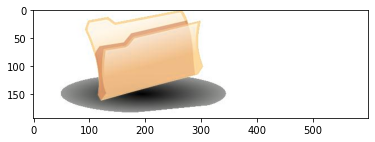

23 23 23
Folder Folder Folder
0.85064393 0.80812573


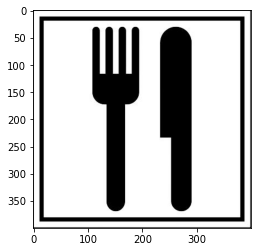

24 24 24
Fork Fork Fork
0.9996509 1.0


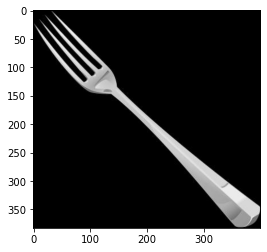

24 24 24
Fork Fork Fork
0.43763736 0.94238126


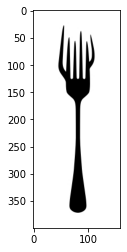

24 24 24
Fork Fork Fork
0.79132414 0.99999976


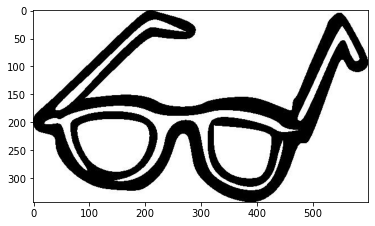

25 25 25
Glasses Glasses Glasses
0.977729 0.99999666


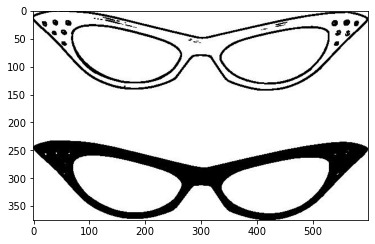

25 25 25
Glasses Glasses Glasses
0.999987 1.0


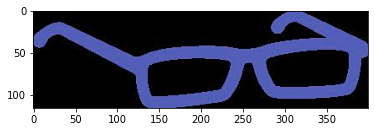

25 25 25
Glasses Glasses Glasses
0.992756 0.99196553


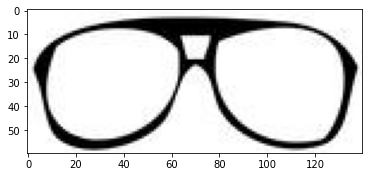

25 25 25
Glasses Glasses Glasses
0.9989848 1.0


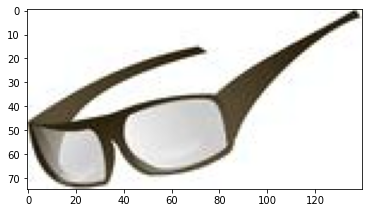

25 25 25
Glasses Glasses Glasses
0.99570376 0.99999994


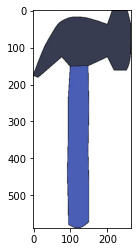

26 26 26
Hammer Hammer Hammer
0.99929404 0.99989235


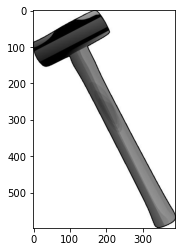

26 26 26
Hammer Hammer Hammer
0.9963722 0.99999076


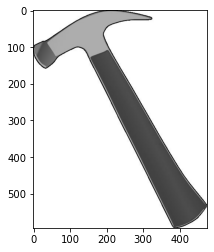

26 26 26
Hammer Hammer Hammer
0.9997001 0.9999442


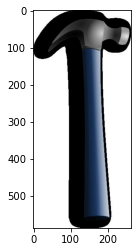

26 26 26
Hammer Hammer Hammer
0.99994826 0.9999998


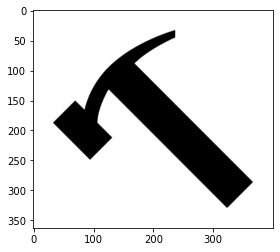

26 26 26
Hammer Hammer Hammer
0.9904562 0.9999997


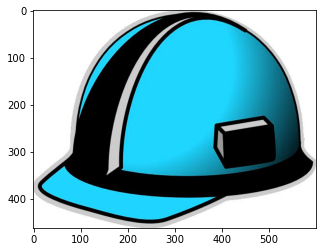

27 27 27
Helmet Helmet Helmet
0.99747986 0.9999977


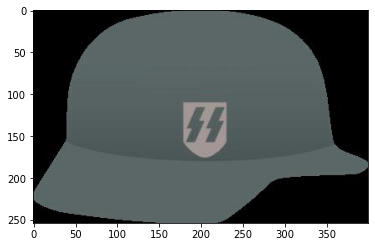

27 27 27
Helmet Helmet Helmet
0.99761117 0.9999992


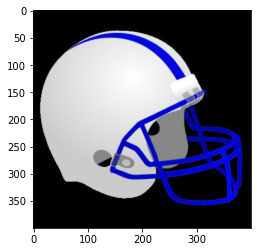

27 27 27
Helmet Helmet Helmet
0.9999872 1.0


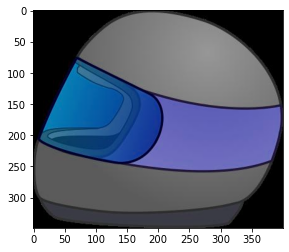

27 27 27
Helmet Helmet Helmet
0.9879772 0.9999717


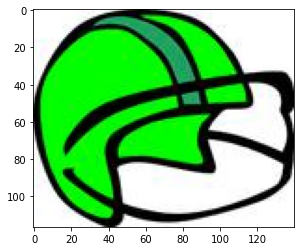

27 27 27
Helmet Helmet Helmet
0.998195 0.9999981


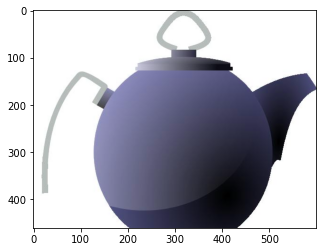

28 28 28
Kettle Kettle Kettle
0.9999646 1.0


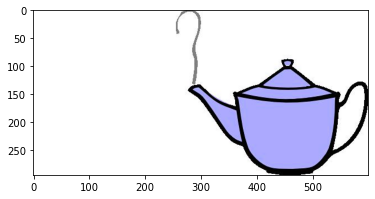

28 28 28
Kettle Kettle Kettle
0.999899 1.0


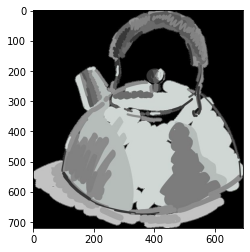

28 28 28
Kettle Kettle Kettle
0.9997436 1.0


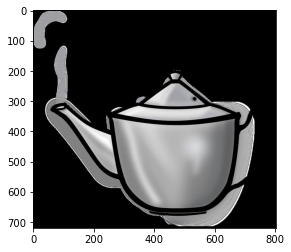

28 28 28
Kettle Kettle Kettle
0.9997178 1.0


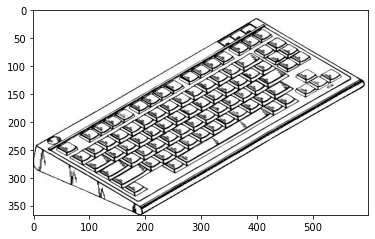

29 29 29
Keyboard Keyboard Keyboard
0.9943528 0.9996397


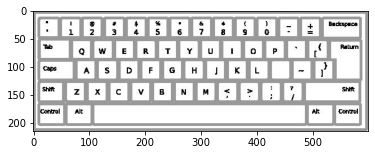

29 29 29
Keyboard Keyboard Keyboard
0.9957338 0.99999976


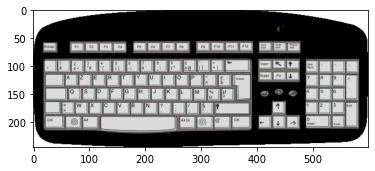

29 29 29
Keyboard Keyboard Keyboard
0.99280417 0.9999641


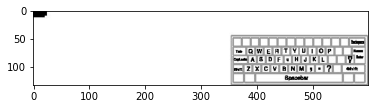

29 29 29
Keyboard Keyboard Keyboard
0.9287838 0.9213024


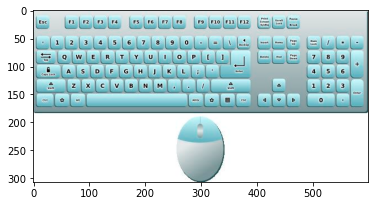

29 29 29
Keyboard Keyboard Keyboard
0.9895758 0.99995965


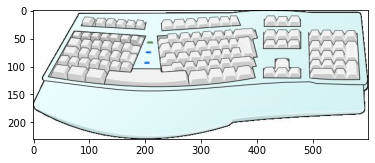

29 29 29
Keyboard Keyboard Keyboard
0.97881013 0.99742824


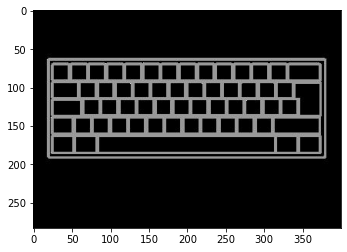

29 29 29
Keyboard Keyboard Keyboard
0.99742866 0.9999982


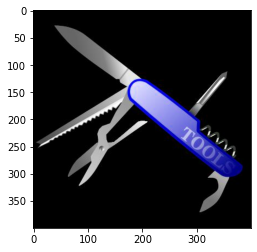

30 30 30
Knives Knives Knives
0.98890424 0.99957937


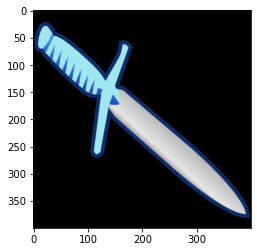

30 30 30
Knives Knives Knives
0.9985202 1.0


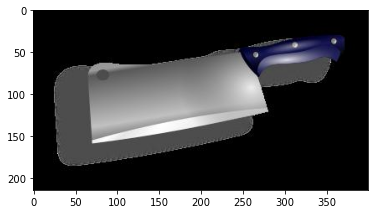

30 30 30
Knives Knives Knives
0.99899876 0.9999944


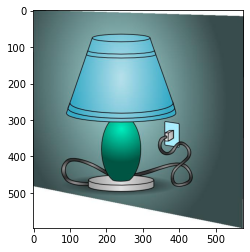

31 31 31
Lamp_Shade Lamp_Shade Lamp_Shade
0.98764473 0.9480388


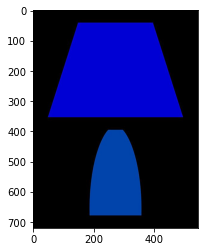

31 31 31
Lamp_Shade Lamp_Shade Lamp_Shade
0.9998409 0.99997115


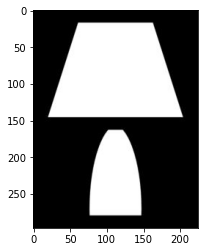

31 31 31
Lamp_Shade Lamp_Shade Lamp_Shade
0.9996405 0.9998666


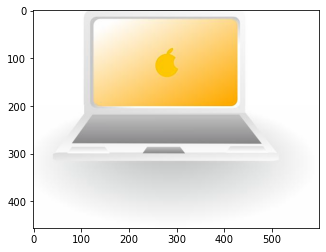

32 32 32
Laptop Laptop Laptop
0.9994431 0.9999999


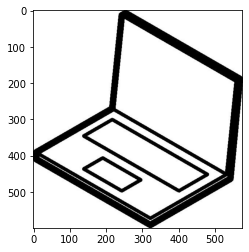

32 32 32
Laptop Laptop Laptop
0.99717057 0.9999998


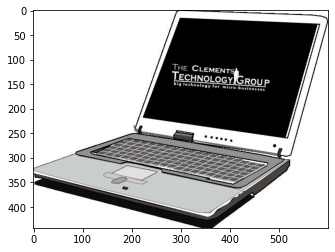

32 32 32
Laptop Laptop Laptop
0.99932027 0.9999999


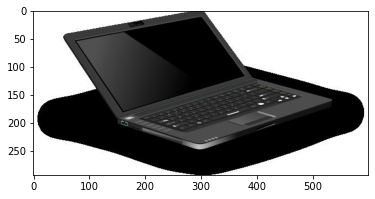

32 32 32
Laptop Laptop Laptop
0.9991453 0.9999998


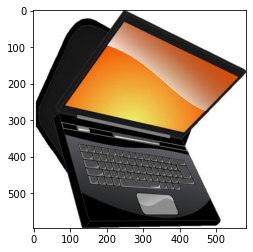

32 32 32
Laptop Laptop Laptop
0.99056315 0.99999315


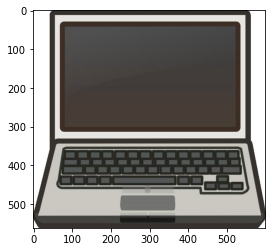

32 32 32
Laptop Laptop Laptop
0.9982326 0.999806


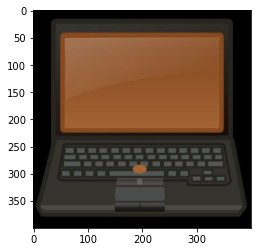

32 32 32
Laptop Laptop Laptop
0.9989966 0.9999988


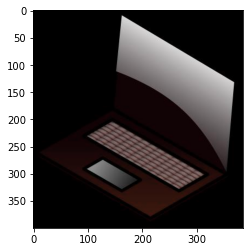

32 32 32
Laptop Laptop Laptop
0.9971909 0.9999994


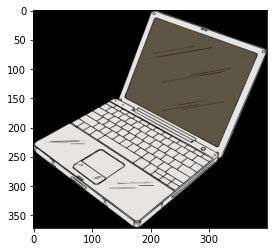

32 32 32
Laptop Laptop Laptop
0.9988709 1.0


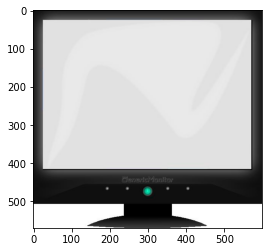

34 34 34
Monitor Monitor Monitor
0.5397378 0.9976611


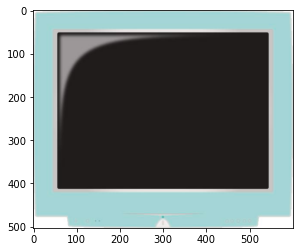

34 34 34
Monitor Monitor Monitor
0.99913836 0.99966145


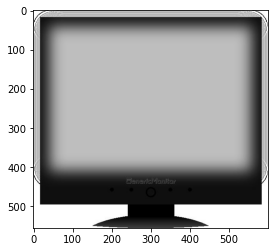

34 34 34
Monitor Monitor Monitor
0.96743065 0.99913967


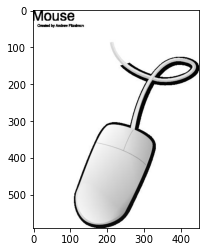

36 36 36
Mouse Mouse Mouse
0.9966505 0.9999999


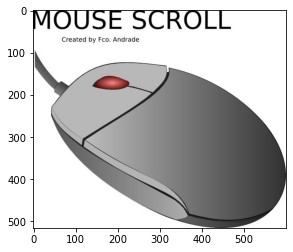

36 36 36
Mouse Mouse Mouse
0.9988967 1.0


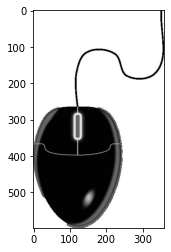

36 36 36
Mouse Mouse Mouse
0.88476264 0.9999866


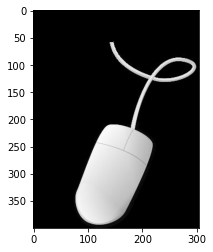

36 36 36
Mouse Mouse Mouse
0.9988899 1.0


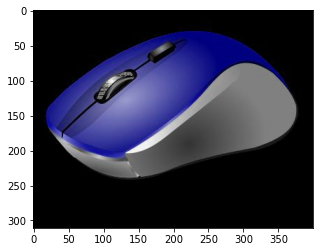

36 36 36
Mouse Mouse Mouse
0.99967474 0.99999994


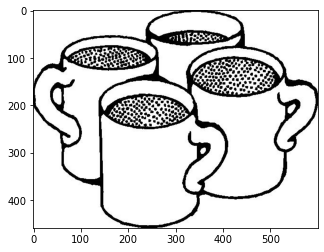

37 37 37
Mug Mug Mug
0.99980587 0.9999998


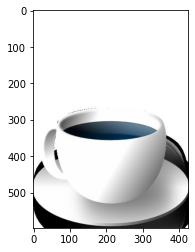

37 37 37
Mug Mug Mug
0.99696654 0.99999934


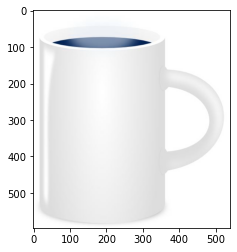

37 37 37
Mug Mug Mug
0.99105304 1.0


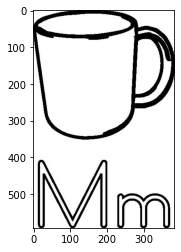

37 37 37
Mug Mug Mug
0.97395104 0.99999297


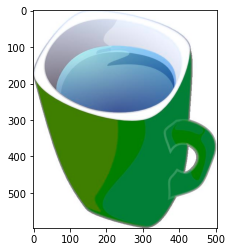

37 37 37
Mug Mug Mug
0.999019 1.0


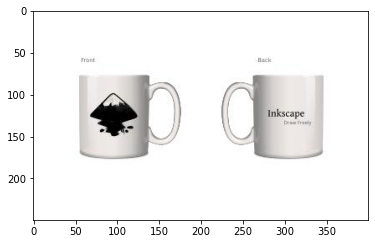

37 37 37
Mug Mug Mug
0.9944278 1.0


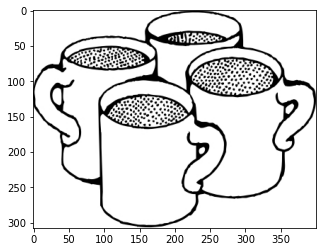

37 37 37
Mug Mug Mug
0.9993064 0.99999934


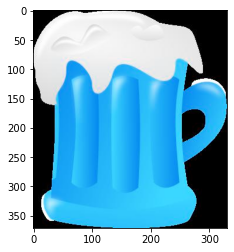

37 37 37
Mug Mug Mug
0.9405162 0.9962826


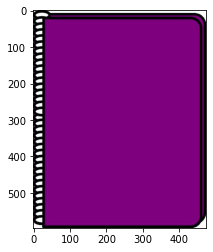

38 38 38
Notebook Notebook Notebook
0.9989301 0.9998543


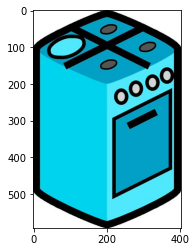

39 39 39
Oven Oven Oven
0.99634933 0.9999147


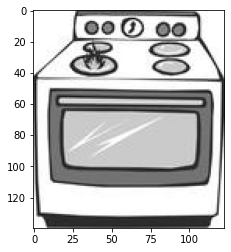

39 39 39
Oven Oven Oven
0.999618 0.9994987


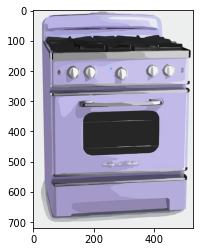

39 39 39
Oven Oven Oven
0.9998607 0.99995923


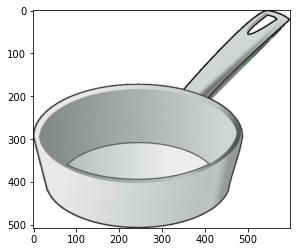

40 40 40
Pan Pan Pan
0.9886171 0.9999651


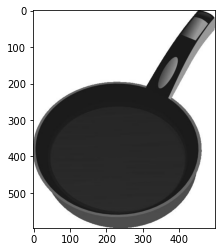

40 40 40
Pan Pan Pan
0.9994535 0.99999976


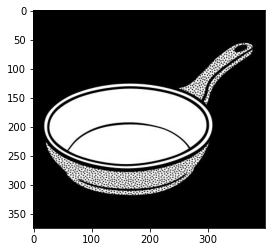

40 40 40
Pan Pan Pan
0.99989045 0.9999964


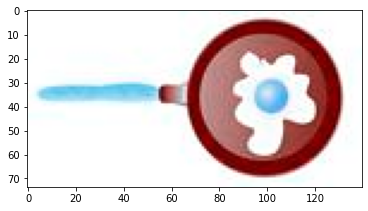

40 40 40
Pan Pan Pan
0.9726557 0.999982


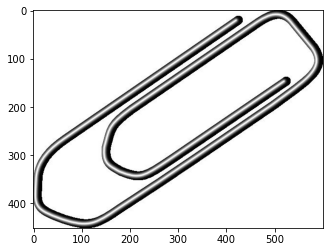

41 41 41
Paper_Clip Paper_Clip Paper_Clip
0.9996768 1.0


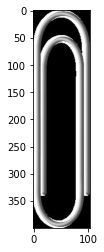

41 41 41
Paper_Clip Paper_Clip Paper_Clip
0.97534347 0.9966175


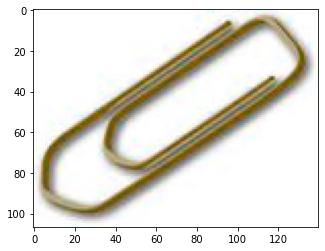

41 41 41
Paper_Clip Paper_Clip Paper_Clip
0.99803746 0.9999995


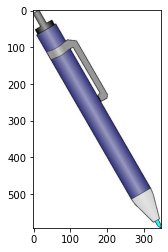

42 42 42
Pen Pen Pen
0.99945545 0.99999374


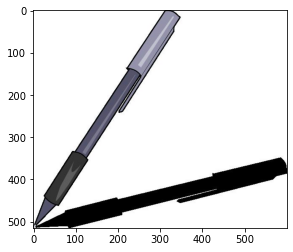

42 42 42
Pen Pen Pen
0.9989332 0.97840613


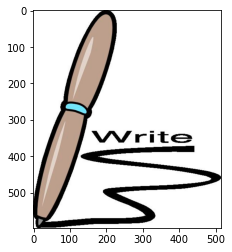

42 42 42
Pen Pen Pen
0.99942887 0.9999996


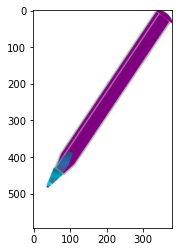

42 42 42
Pen Pen Pen
0.8778645 0.9999194


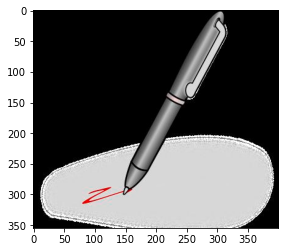

42 42 42
Pen Pen Pen
0.9988555 0.99999905


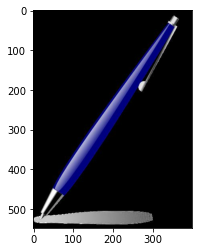

42 42 42
Pen Pen Pen
0.7383267 0.9999972


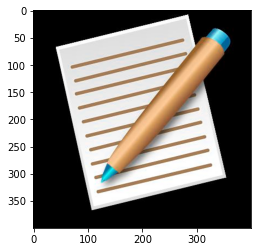

42 42 42
Pen Pen Pen
0.999766 0.8238058


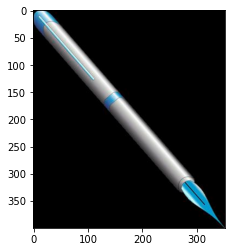

42 42 42
Pen Pen Pen
0.9991254 0.99999493


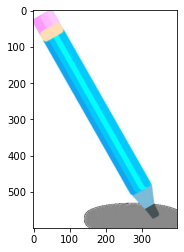

43 43 43
Pencil Pencil Pencil
0.9999892 0.99811584


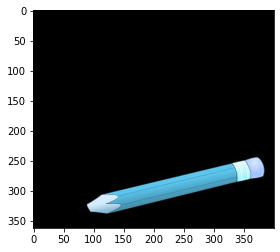

43 43 43
Pencil Pencil Pencil
0.9983947 0.9939106


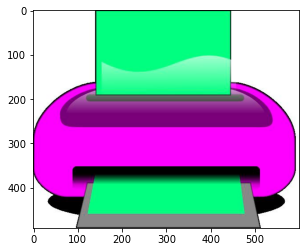

45 45 45
Printer Printer Printer
0.9286404 0.80857795


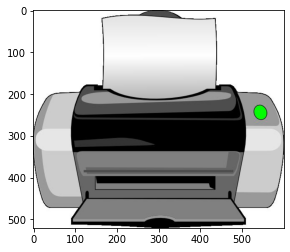

45 45 45
Printer Printer Printer
0.9999615 0.99999857


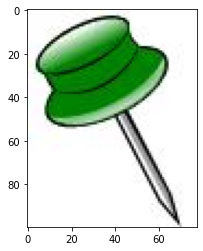

46 46 46
Push_Pin Push_Pin Push_Pin
0.9939693 1.0


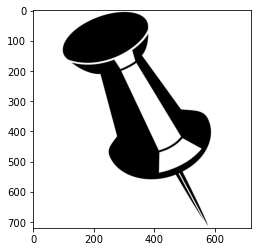

46 46 46
Push_Pin Push_Pin Push_Pin
0.9773159 0.9992852


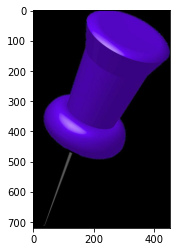

46 46 46
Push_Pin Push_Pin Push_Pin
0.9962926 0.9999951


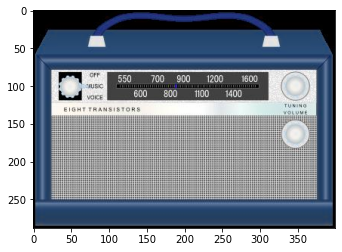

47 47 47
Radio Radio Radio
0.99563307 0.9999999


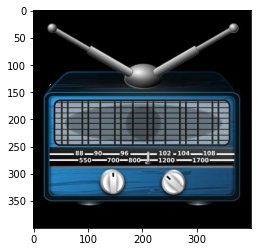

47 47 47
Radio Radio Radio
0.9976592 1.0


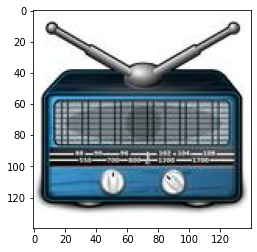

47 47 47
Radio Radio Radio
0.99980307 1.0


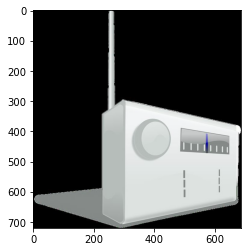

47 47 47
Radio Radio Radio
0.9942478 0.9999978


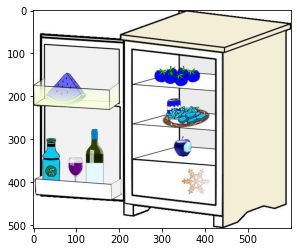

48 48 48
Refrigerator Refrigerator Refrigerator
0.8819084 0.999999


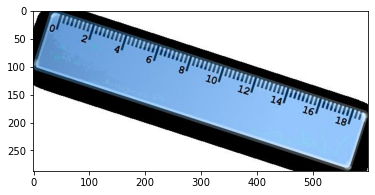

49 49 49
Ruler Ruler Ruler
0.99789196 1.0


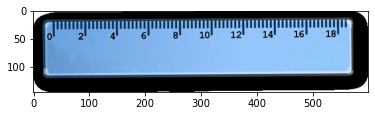

49 49 49
Ruler Ruler Ruler
0.9961749 1.0


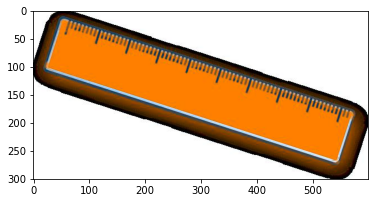

49 49 49
Ruler Ruler Ruler
0.9967925 1.0


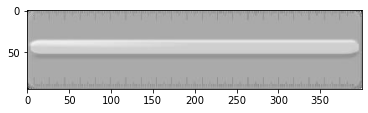

49 49 49
Ruler Ruler Ruler
0.9998495 0.9999961


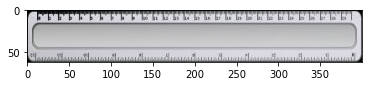

49 49 49
Ruler Ruler Ruler
0.9997038 1.0


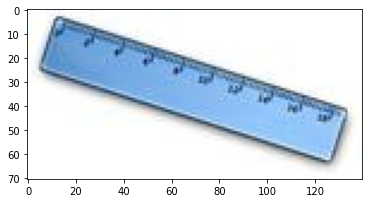

49 49 49
Ruler Ruler Ruler
0.9937577 1.0


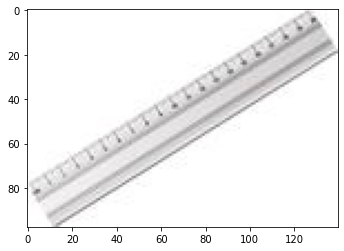

49 49 49
Ruler Ruler Ruler
0.994747 1.0


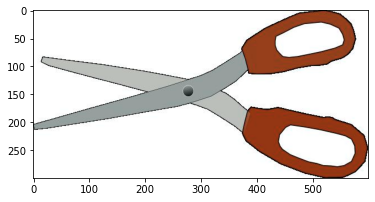

50 50 50
Scissors Scissors Scissors
0.99720466 0.9999808


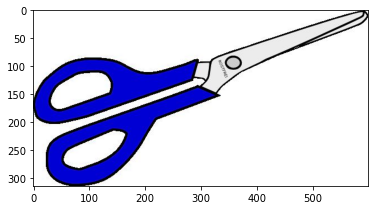

50 50 50
Scissors Scissors Scissors
0.99599665 0.9999988


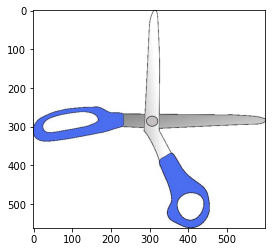

50 50 50
Scissors Scissors Scissors
0.9979194 0.9998925


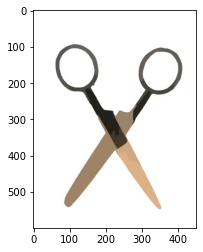

50 50 50
Scissors Scissors Scissors
0.9660235 0.99955696


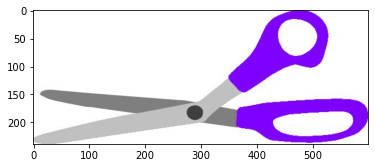

50 50 50
Scissors Scissors Scissors
0.9987745 0.9999996


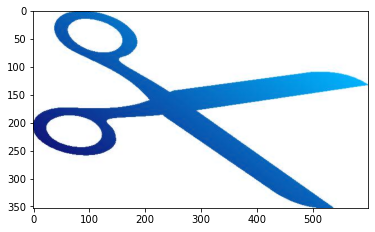

50 50 50
Scissors Scissors Scissors
0.9966034 0.9999761


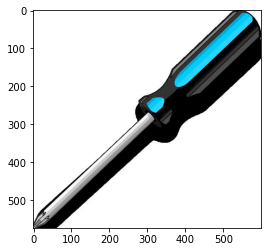

51 51 51
Screwdriver Screwdriver Screwdriver
0.9901872 1.0


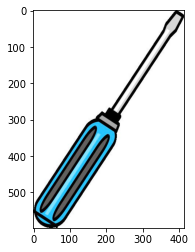

51 51 51
Screwdriver Screwdriver Screwdriver
0.9926012 1.0


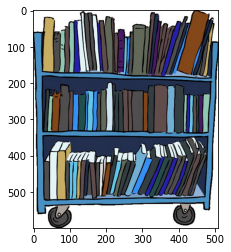

52 52 52
Shelf Shelf Shelf
0.99359566 0.85599035


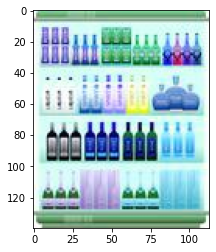

52 52 52
Shelf Shelf Shelf
0.993509 0.99999976


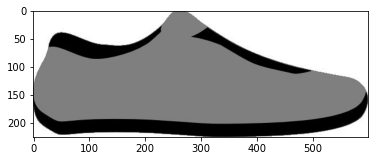

54 54 54
Sneakers Sneakers Sneakers
0.9912195 0.99399555


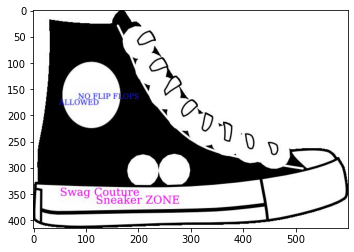

54 54 54
Sneakers Sneakers Sneakers
0.99996233 0.99999255


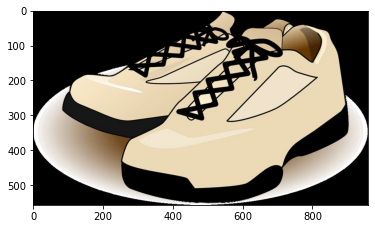

54 54 54
Sneakers Sneakers Sneakers
0.9975162 1.0


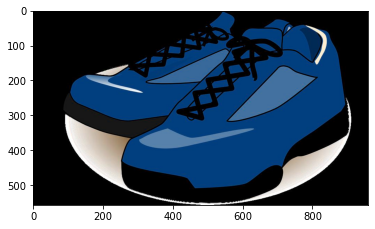

54 54 54
Sneakers Sneakers Sneakers
0.9993295 0.99999744


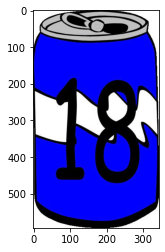

55 55 55
Soda Soda Soda
0.99440366 0.9995477


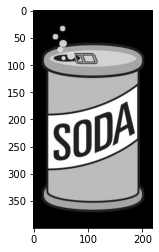

55 55 55
Soda Soda Soda
0.9993155 0.99996805


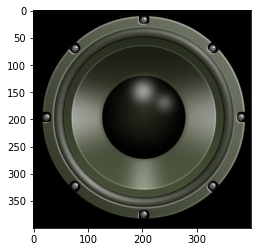

56 56 56
Speaker Speaker Speaker
0.99174064 0.99995023


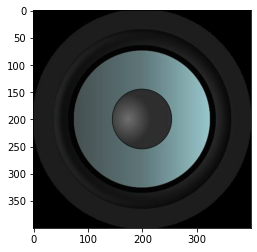

56 56 56
Speaker Speaker Speaker
0.9826272 0.9999486


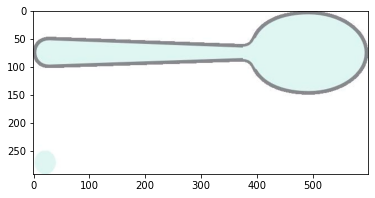

57 57 57
Spoon Spoon Spoon
0.9779972 0.7691814


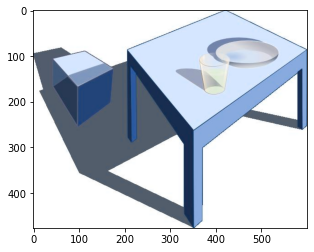

58 58 58
Table Table Table
0.99874574 0.99999964


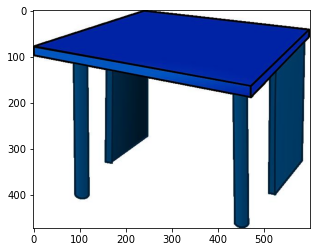

58 58 58
Table Table Table
0.9990774 0.9999985


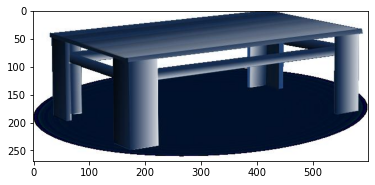

58 58 58
Table Table Table
0.9999219 0.99999976


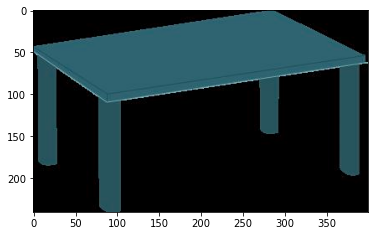

58 58 58
Table Table Table
0.99944437 1.0


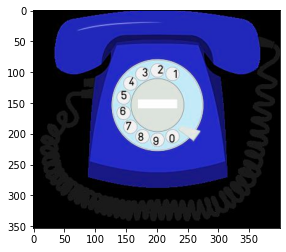

59 59 59
Telephone Telephone Telephone
0.9999778 1.0


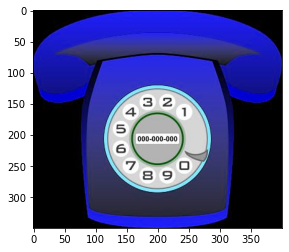

59 59 59
Telephone Telephone Telephone
0.99876237 0.9999998


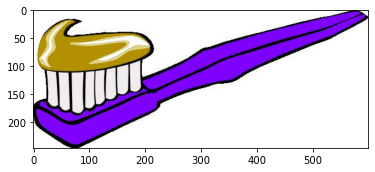

60 60 60
ToothBrush ToothBrush ToothBrush
0.998978 1.0


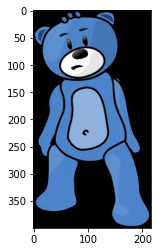

61 61 61
Toys Toys Toys
0.9978046 0.99966484


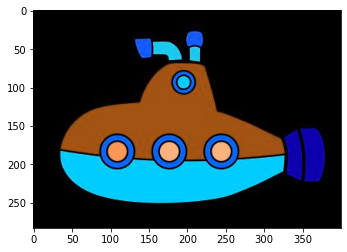

61 61 61
Toys Toys Toys
0.99888635 0.9877714


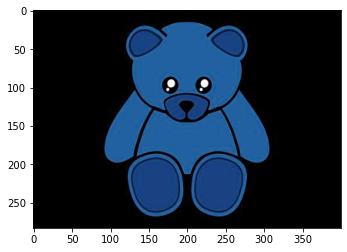

61 61 61
Toys Toys Toys
0.99906915 0.9999916


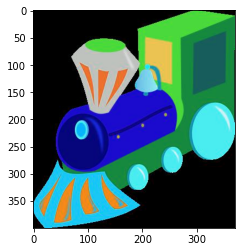

61 61 61
Toys Toys Toys
0.9932906 0.48536026


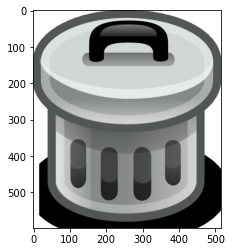

62 62 62
Trash_Can Trash_Can Trash_Can
0.9332303 0.9906386


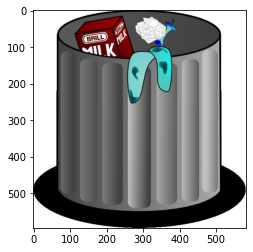

62 62 62
Trash_Can Trash_Can Trash_Can
0.9998602 0.99999905


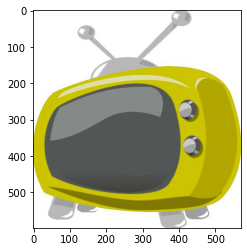

63 63 63
TV TV TV
0.7569204 0.9999978


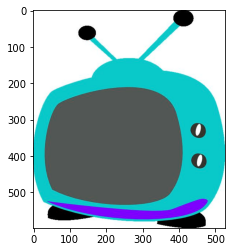

63 63 63
TV TV TV
0.9699932 0.9999977


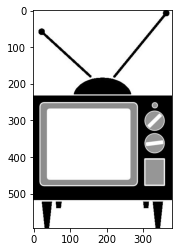

63 63 63
TV TV TV
0.9912685 0.99979115


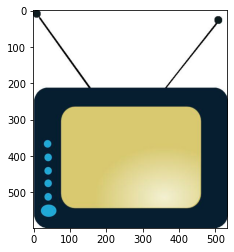

63 63 63
TV TV TV
0.9978466 0.9999908


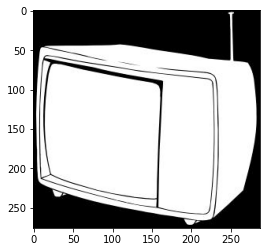

63 63 63
TV TV TV
0.94905686 0.97033495


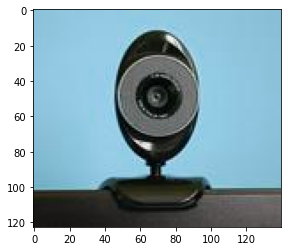

64 64 64
Webcam Webcam Webcam
0.9550955 0.9937966


In [48]:
visualize_image_list(both_win_list,txt_test,answer,shot_raw_predict,shot_predict,sdat_raw_predict,sdat_predict,class_map)

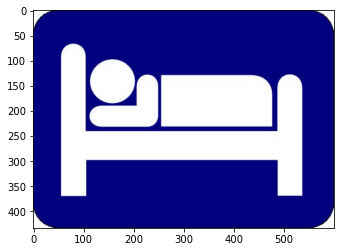

3 3 13
Bed Bed Couch
0.98471045 0.9656679


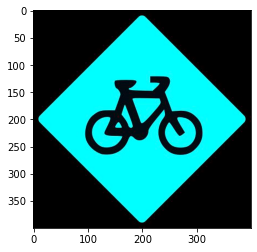

4 4 2
Bike Bike Batteries
0.99999976 0.9665212


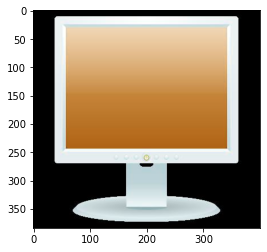

12 12 34
Computer Computer Monitor
0.9999005 0.57941896


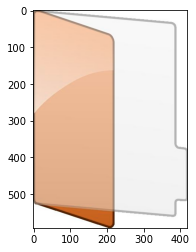

23 23 38
Folder Folder Notebook
0.98854434 0.5565924


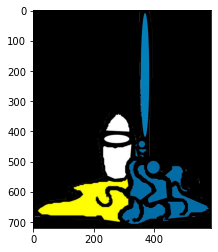

35 35 9
Mop Mop Candles
0.99999046 0.9999997


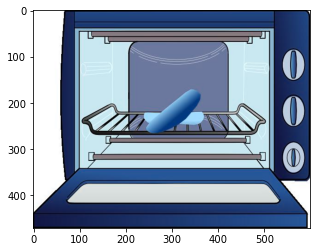

39 39 48
Oven Oven Refrigerator
0.99999607 0.9999892


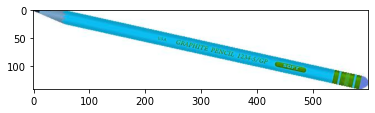

43 43 17
Pencil Pencil Eraser
0.97745293 0.94297695


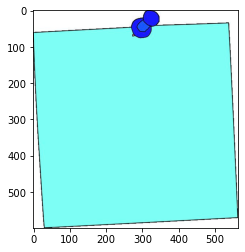

44 44 19
Postit_Notes Postit_Notes Fan
0.99120975 0.6377161


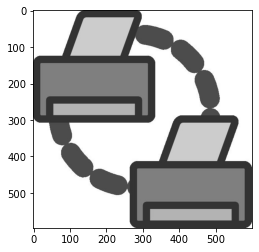

45 45 47
Printer Printer Radio
0.9999759 0.9956318


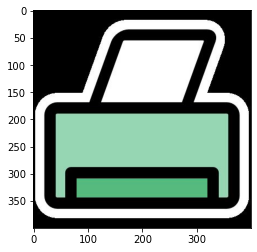

45 45 47
Printer Printer Radio
0.9999742 0.9995762


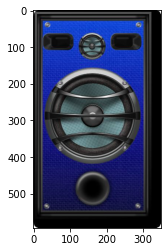

56 56 47
Speaker Speaker Radio
0.99999917 0.96169204


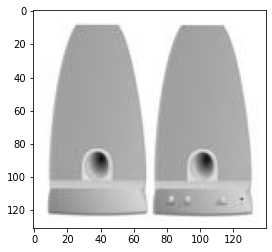

56 56 47
Speaker Speaker Radio
0.82907647 0.9044332


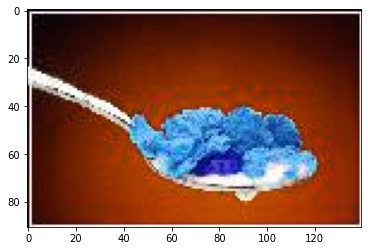

57 57 40
Spoon Spoon Pan
0.9925268 0.59531015


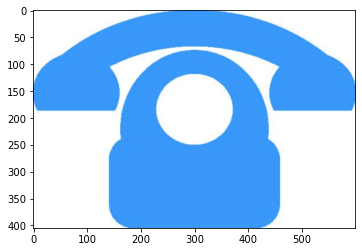

59 59 56
Telephone Telephone Speaker
0.999449 0.9350651


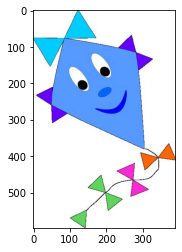

61 61 44
Toys Toys Postit_Notes
0.99991405 0.64169663


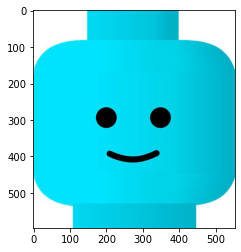

61 61 5
Toys Toys Bottle
0.9668332 0.9999216


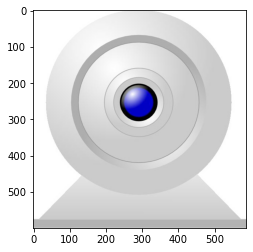

64 64 56
Webcam Webcam Speaker
0.99998105 0.97627425


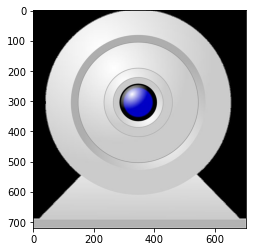

64 64 56
Webcam Webcam Speaker
0.999994 0.90262103


In [79]:
visualize_image_list(shotsdat_win_list,txt_test,answer,shotsdat_raw_predict,shotsdat_predict,sdat_raw_predict,sdat_predict,class_map)

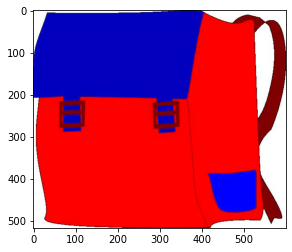

1 44 1
Backpack Postit_Notes Backpack
0.9999211 0.99935126


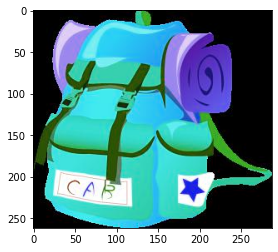

1 55 1
Backpack Soda Backpack
0.9997387 0.9576159


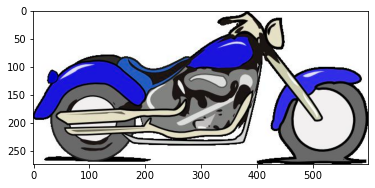

4 54 4
Bike Sneakers Bike
0.9999374 0.87890804


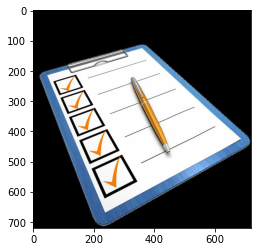

11 38 11
Clipboards Notebook Clipboards
0.9955564 0.88527155


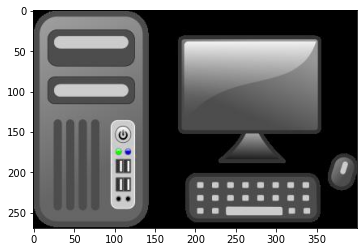

12 7 12
Computer Calculator Computer
0.9947878 0.54709184


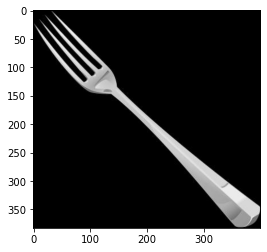

24 57 24
Fork Spoon Fork
0.48294914 0.94238126


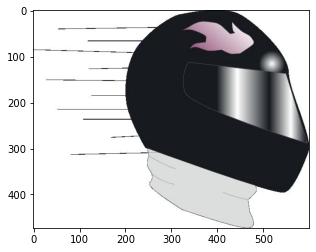

27 36 27
Helmet Mouse Helmet
0.9859926 0.9403249


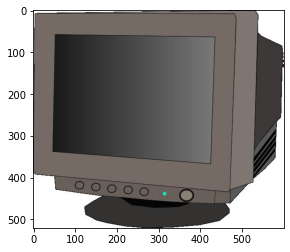

34 12 34
Monitor Computer Monitor
0.6008655 0.9995643


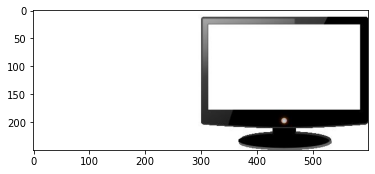

34 12 34
Monitor Computer Monitor
0.9979092 0.877262


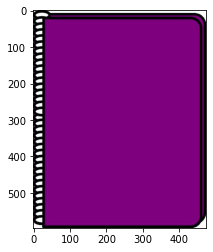

38 44 38
Notebook Postit_Notes Notebook
0.99998134 0.9998543


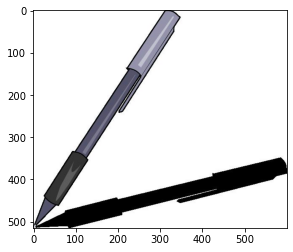

42 30 42
Pen Knives Pen
0.99973524 0.97840613


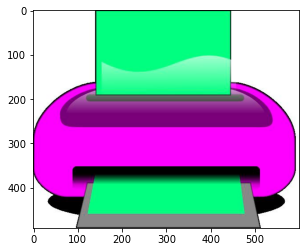

45 55 45
Printer Soda Printer
0.99703914 0.80857795


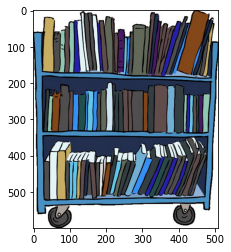

52 33 52
Shelf Marker Shelf
0.9974941 0.85599035


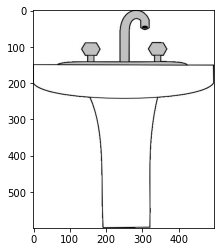

53 28 53
Sink Kettle Sink
0.99962 0.9980975


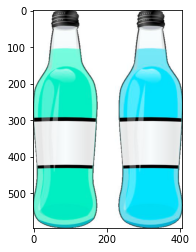

55 5 55
Soda Bottle Soda
0.99995434 0.98987037


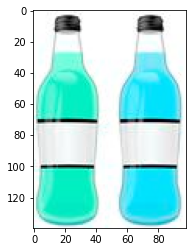

55 5 55
Soda Bottle Soda
0.9999783 0.9914557


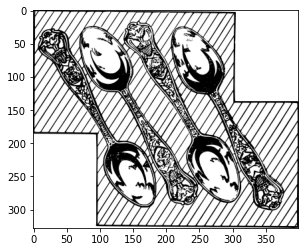

57 50 57
Spoon Scissors Spoon
0.99743855 0.9869621


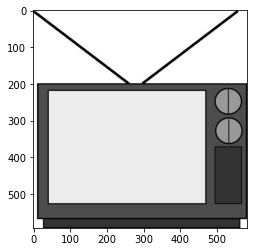

63 11 63
TV Clipboards TV
0.8930616 0.711688


In [80]:
visualize_image_list(shotsdat_lose_list,txt_test,answer,shotsdat_raw_predict,shotsdat_predict,sdat_raw_predict,sdat_predict,class_map)